# Load package and figure settings

In [ ]:
import episcanpy as epi
import anndata as ad
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
sc.settings.set_figure_params(dpi=80, color_map='gist_earth')

In [ ]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

# Promoters

In [ ]:
DATADIR = ''
adata = ad.read(DATADIR+'processed_promoter_CG_luo_et_al_nov2020_paper_resubmission.h5ad')
adata

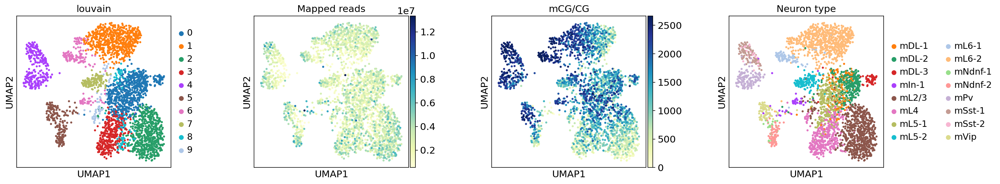

In [6]:
epi.pl.umap(adata,
            color=['louvain', 'Mapped reads', 'mCG/CG', 'Neuron type'],
            wspace=0.4,
            save='_promoters_CG_nov2nd2020.png')

In [7]:
adata.uns['Neuron type_colors']

array(['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'], dtype=object)

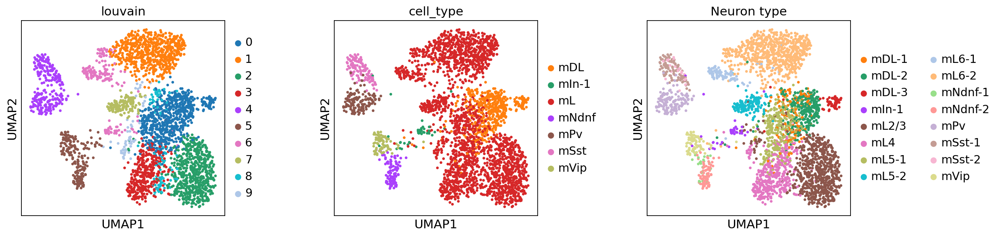

In [8]:
epi.pl.umap(adata, color=['louvain', 'cell_type', 'Neuron type'], wspace=0.4)

<Figure size 800x800 with 0 Axes>

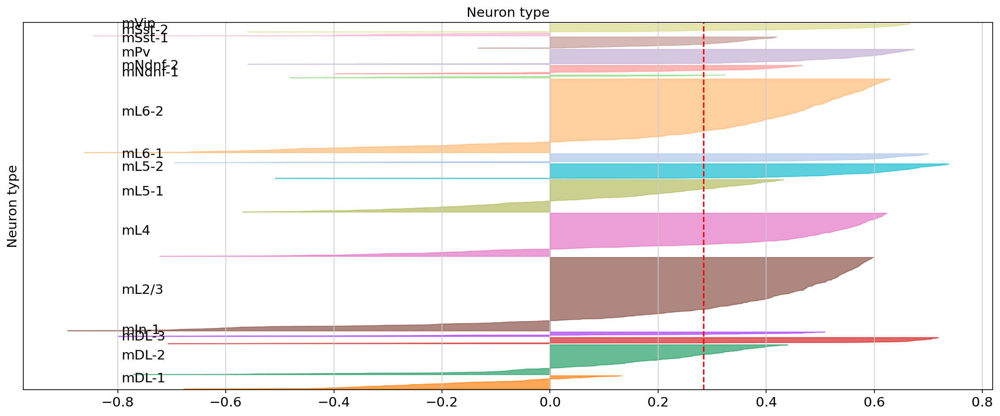

0.28426886


()

In [11]:
plt.figure(figsize=(10,10))
epi.pl.silhouette_tot(adata,
                      'Neuron type',
                      value='X_umap',
                      palette=['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
                      name_cluster=True)




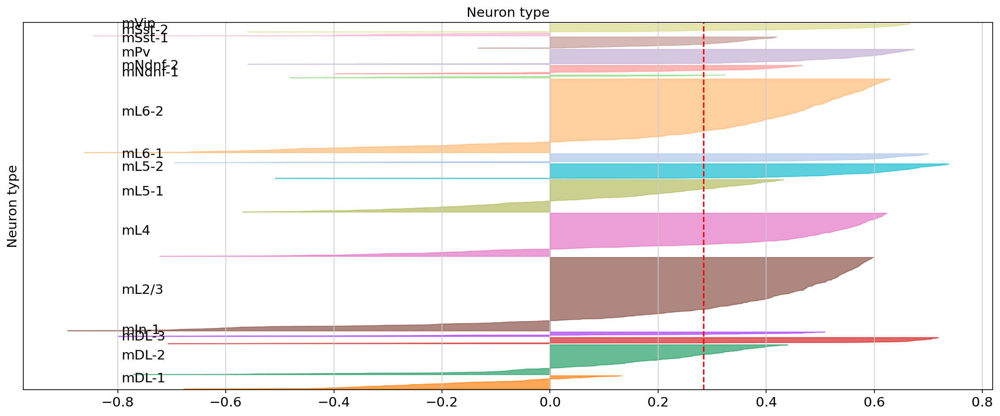

0.28426886


()

In [12]:
epi.pl.silhouette_tot(adata,
                      'Neuron type',
                      value='X_umap',
                      palette=adata.uns['Neuron type_colors'].tolist(),
                      name_cluster=True)



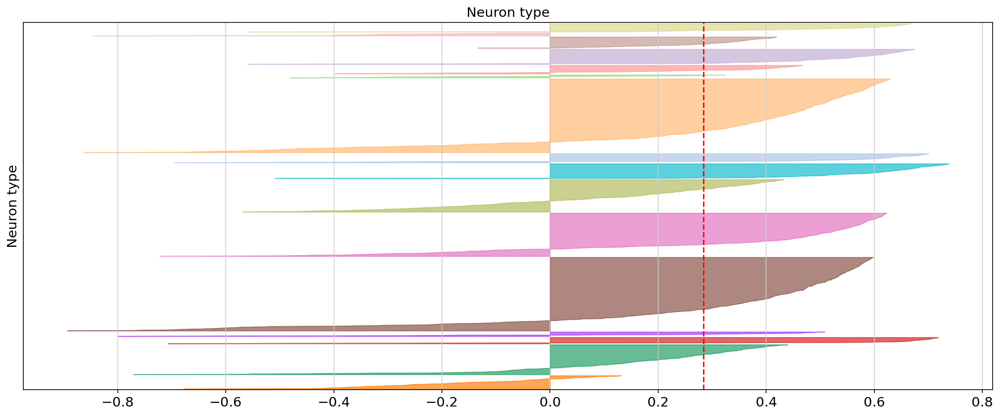

0.28426886


()

In [13]:
epi.pl.silhouette_tot(adata,
                      'Neuron type',
                      value='X_umap',
                      name_cluster=False,
                      palette=adata.uns['Neuron type_colors'].tolist(),
                      save='silhouette_promoters_umap_neuron_type_CG.png')


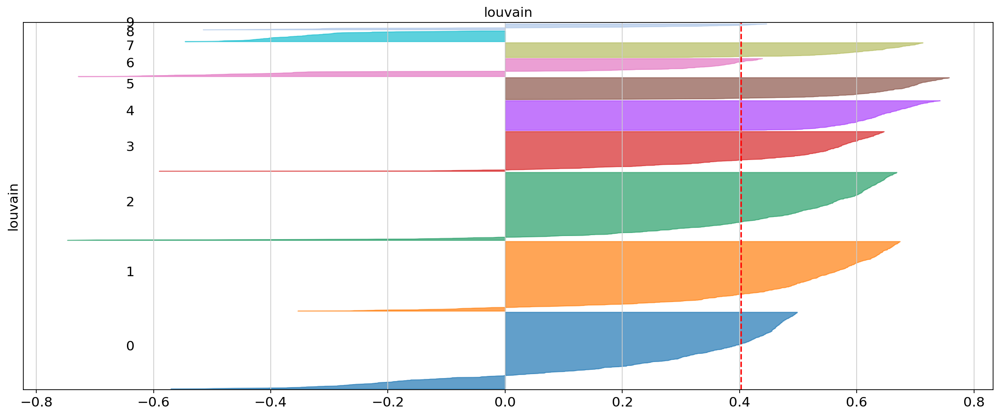

0.4022649


()

In [14]:
epi.pl.silhouette_tot(adata,
                      'louvain',
                      value='X_umap',
                      palette=adata.uns['louvain_colors'].tolist(),
                      name_cluster=True)

# Markers for methylation

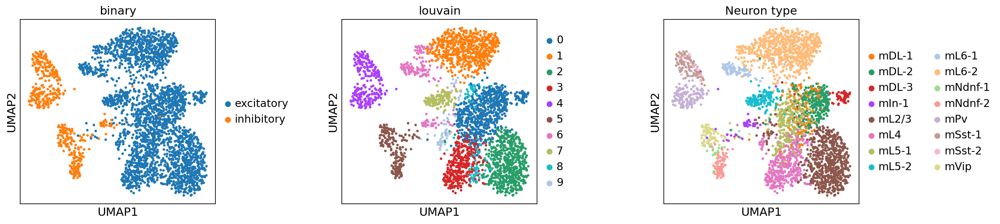

In [15]:
sc.pl.umap(adata, color=['binary', 'louvain', 'Neuron type'], wspace=0.5)

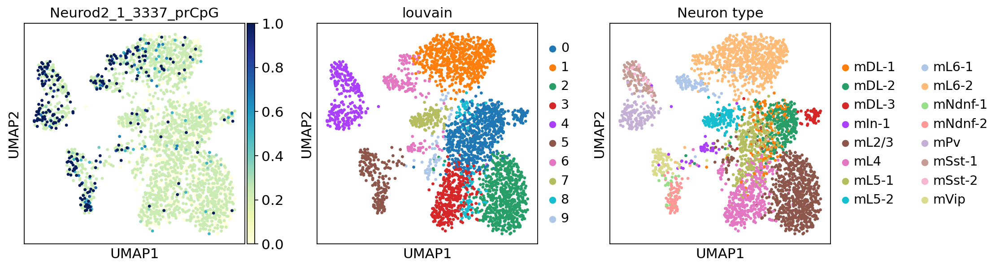

In [16]:
sc.pl.umap(adata, color=['Neurod2_1_3337_prCpG', 'louvain', 'Neuron type'])

In [17]:
adata

AnnData object with n_obs × n_vars = 3224 × 32610
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'louvain', 'silhouette_samples'
    uns: 'Estimated mCG', 'Estimated mCH', 'Neuron type_colors', 'cell_type_colors', 'louvain', 'louvain_colors', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca', 'umap', 'binary_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [18]:
#sc.pl.umap(adata, color=['Neurod2_1_3337_prCpG_imputed', 'louvain', 'Neuron type'])

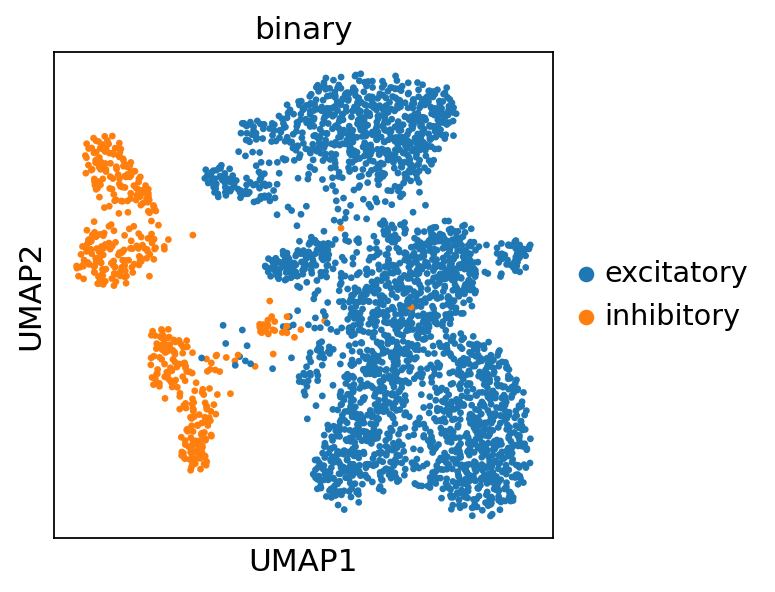

In [19]:
sc.pl.umap(adata, color=['binary'])

In [22]:
adata.write('processed_promoter_CG_methylation_nov2020.h5ad')

In [20]:
for n in adata.var_names.tolist():
    if 'Neurod2' in n:
        print(n)

Neurod2_1_3337_prCpG


In [ ]:
epi.tl.imputation_feature(adata, 'Neurod2_1_3337_prCpG', 'Neuron type')
sc.pl.umap(adata, color=['Neurod2_1_3337_prCpG', 'Neuron type'])
sc.pl.umap(adata, color=['Neurod2_1_3337_prCpG_imputed'],
           title='Neurod2', save='Neurod2.png')
adata

In [ ]:
sc.pl.umap(adata, color=['binary'], save='binary.png')
sc.pl.umap(adata,
           color=['Neurod2_1_3337_prCpG_imputed'],
           save='Neurod2.png',
          title='Neurod2')

In [ ]:
adata.obs['Neurod2'] = adata.obs['Neurod2_1_3337_prCpG_imputed'].copy()
sc.pl.violin(adata,
             keys='Neurod2',
            groupby='binary', save='Neurod2.png')

In [ ]:
adata.obs['Neurod2'] = adata.obs['Neurod2_1_3337_prCpG_imputed'].copy()
sc.pl.violin(adata,
             keys='Neurod2', rotation=90,
            groupby='Neuron type', save='Neurod2_neuron_type.png')

In [ ]:
adata2 = adata[adata.obs['binary']!='inhibitory',:].copy()
adata2

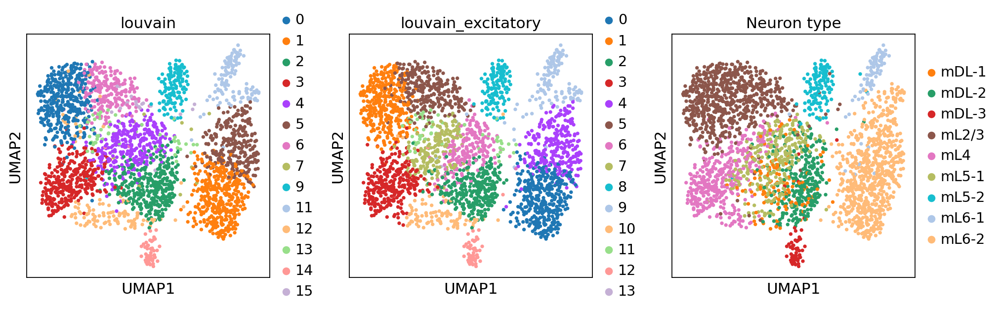

In [117]:
epi.pp.lazy(adata2)
sc.tl.louvain(adata2, resolution=2, key_added='louvain_excitatory')
sc.pl.umap(adata2, color=['louvain', 'louvain_excitatory', 'Neuron type'])

# markers

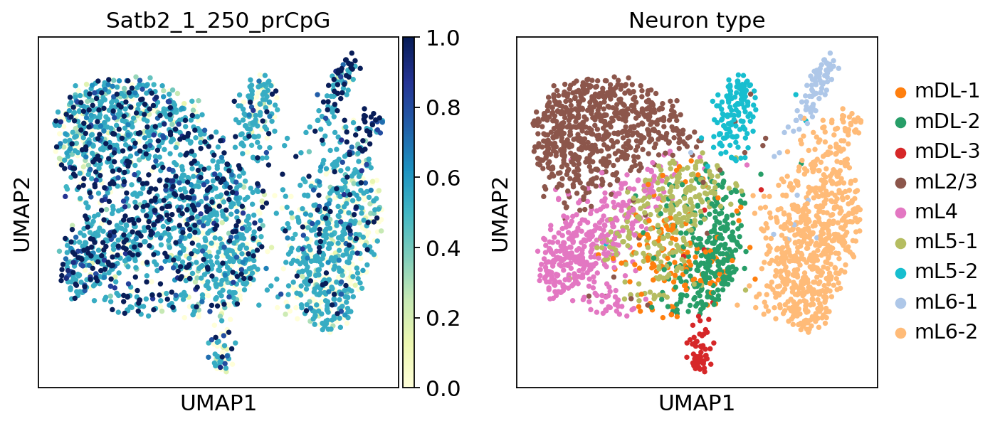

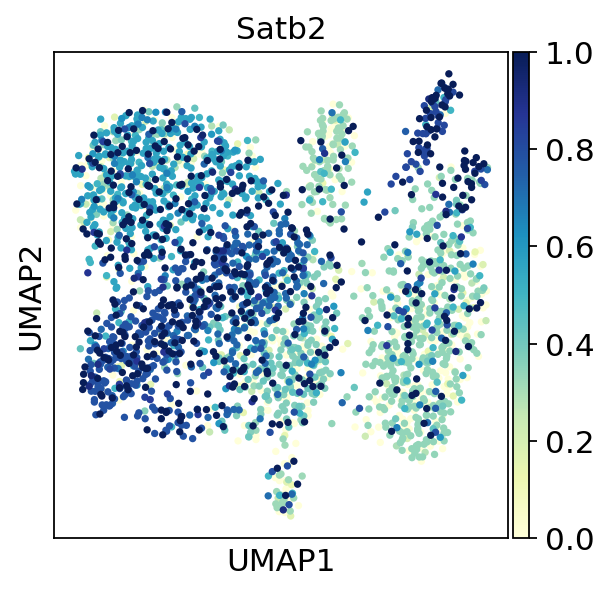

AnnData object with n_obs × n_vars = 2734 × 32610
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'louvain', 'Neurod2_1_3337_prCpG_no_input', 'Neurod2_1_3337_prCpG_imputed', 'louvain_promoter', 'louvain_enhancers', 'louvain_promoters', 'louvain_windows', 'louvain_genebodies', 'Neurod2', 'louvain_excitatory', 'Satb2_1_250_prCpG_no_input', 'Satb2_1_250_prCpG_imputed'
    uns: 'Estimated mCG', 'Estimated mCH', 'Neuron type_colors', 'cell_type_colors', 'louvain', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca', 'umap', 'binary_colors', 'louvain_promoter_colors', 'louvain_promoters_colors', 'louvain_colors', 'louvain_excitatory_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'c

In [118]:
imputation(adata2, 'Satb2_1_250_prCpG','Neuron type')
sc.pl.umap(adata2, color=['Satb2_1_250_prCpG', 'Neuron type'])
sc.pl.umap(adata2, color=['Satb2_1_250_prCpG_imputed'],
           title='Satb2', save='Satb2.png')
adata2

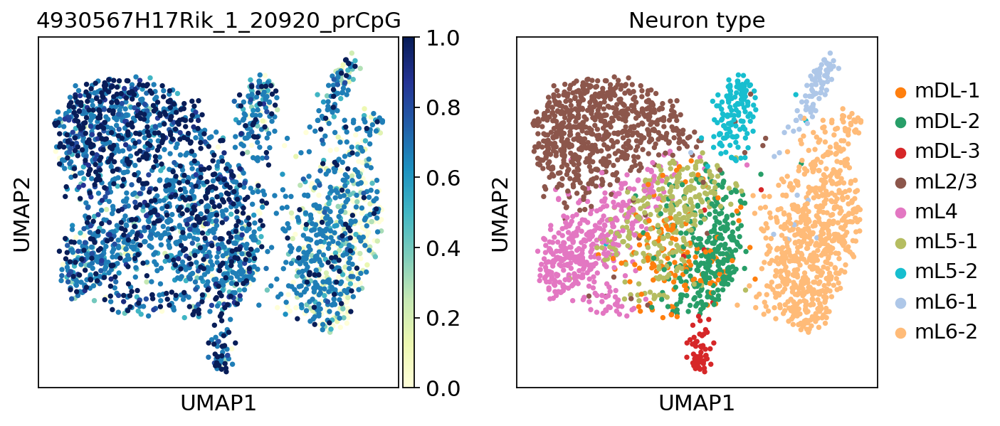

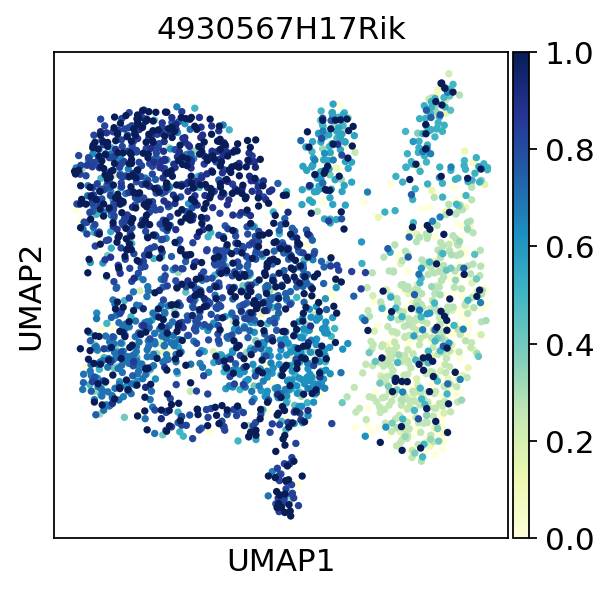

AnnData object with n_obs × n_vars = 2734 × 32610
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'louvain', 'Neurod2_1_3337_prCpG_no_input', 'Neurod2_1_3337_prCpG_imputed', 'louvain_promoter', 'louvain_enhancers', 'louvain_promoters', 'louvain_windows', 'louvain_genebodies', 'Neurod2', 'louvain_excitatory', 'Satb2_1_250_prCpG_no_input', 'Satb2_1_250_prCpG_imputed', '4930567H17Rik_1_20920_prCpG_no_input', '4930567H17Rik_1_20920_prCpG_imputed'
    uns: 'Estimated mCG', 'Estimated mCH', 'Neuron type_colors', 'cell_type_colors', 'louvain', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca', 'umap', 'binary_colors', 'louvain_promoter_colors', 'louvain_promoters_colors', 'louvain_colors', 'louvain_excitatory_colors'


In [120]:
imputation(adata2, '4930567H17Rik_1_20920_prCpG','louvain_excitatory')
sc.pl.umap(adata2, color=['4930567H17Rik_1_20920_prCpG', 'Neuron type'])
sc.pl.umap(adata2, color=['4930567H17Rik_1_20920_prCpG'+'_imputed'],
           title='4930567H17Rik',save='4930567H17Rik.png')
adata2

... storing 'layer' as categorical


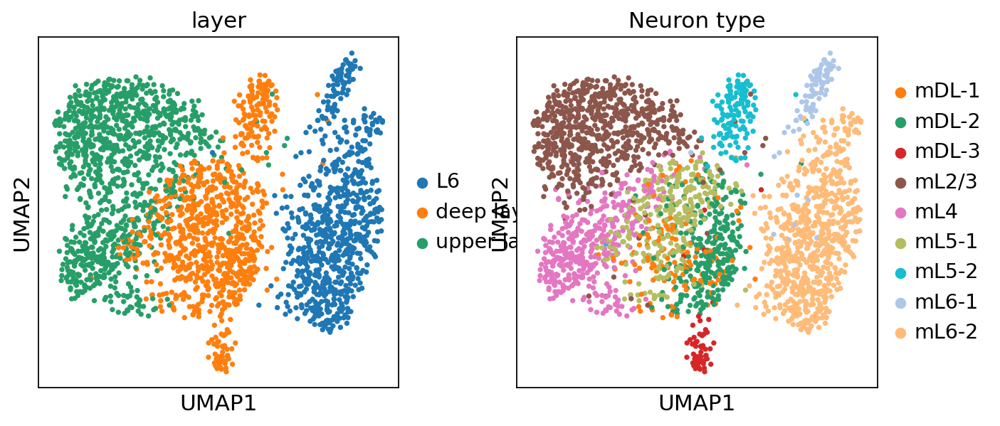

In [121]:
annot = []
for n in adata2.obs['Neuron type']:
    if n in ['mL6-1', 'mL6-2']:
        annot.append('L6')
    elif n in ['mL5-1', 'mL5-2', 'mDL-1', 'mDL-2', 'mDL-3']:
        annot.append('deep layer - L5')
    else:
        annot.append('upper layer - L2/3-4')
        
adata2.obs['layer'] = annot        
sc.pl.umap(adata2, color=['layer', 'Neuron type'])


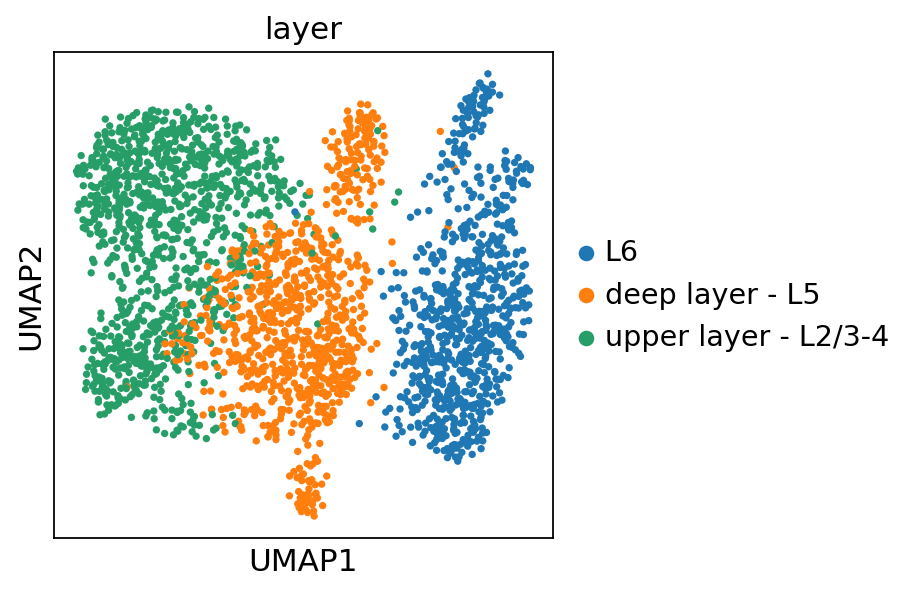

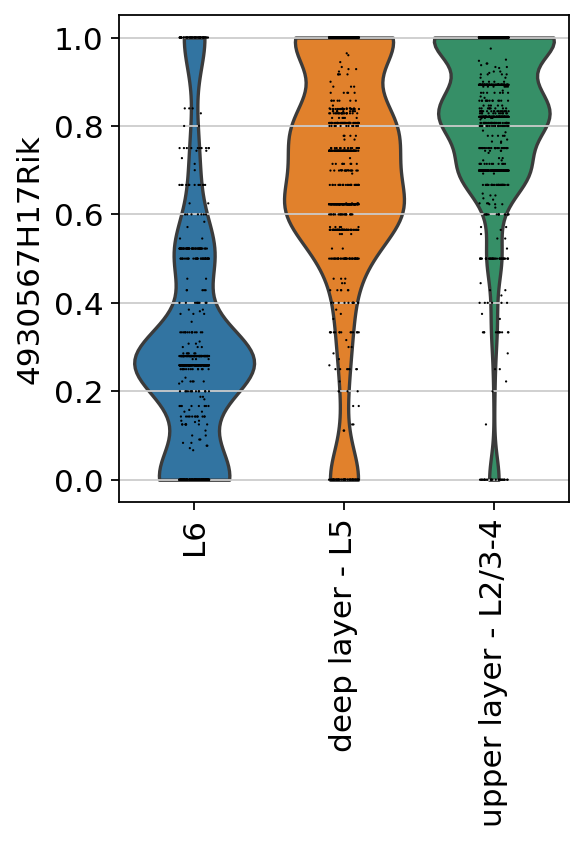

In [122]:
sc.pl.umap(adata2, color=['layer'], save='excitatory_layers.png')
adata2.obs['4930567H17Rik'] = adata2.obs['4930567H17Rik_1_20920_prCpG_imputed'].copy()
sc.pl.violin(adata2,
             keys='4930567H17Rik', rotation=90,
            groupby='layer', save='4930567H17Rik.png')

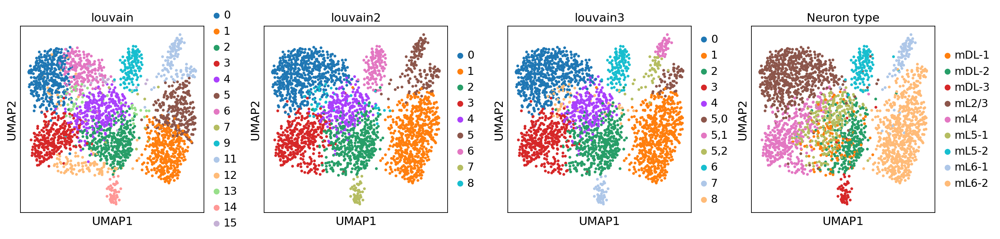

In [123]:
sc.tl.louvain(adata2, resolution=1, key_added='louvain2')
sc.tl.louvain(adata2, restrict_to=['louvain2', ['5']], key_added='louvain3')
sc.pl.umap(adata2, color=['louvain', 'louvain2', 'louvain3', 'Neuron type'])

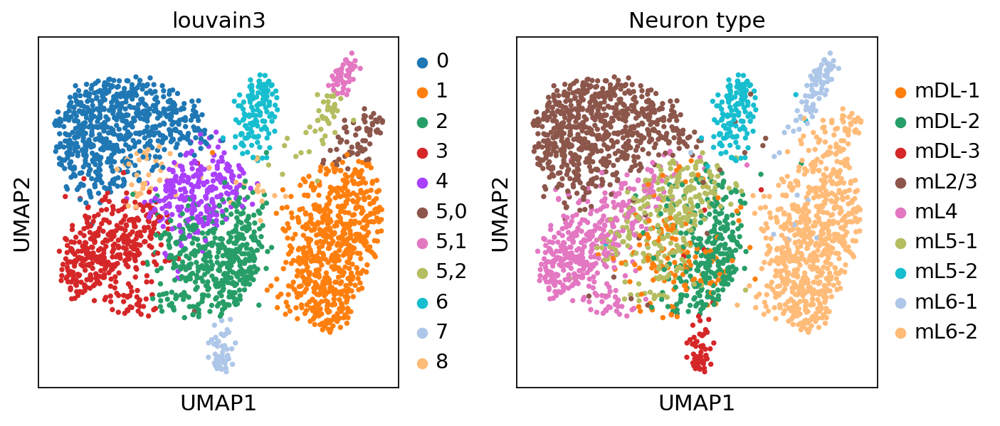

In [124]:
sc.pl.umap(adata2, color=['louvain3', 'Neuron type'])

... storing 'excitatory neurons' as categorical


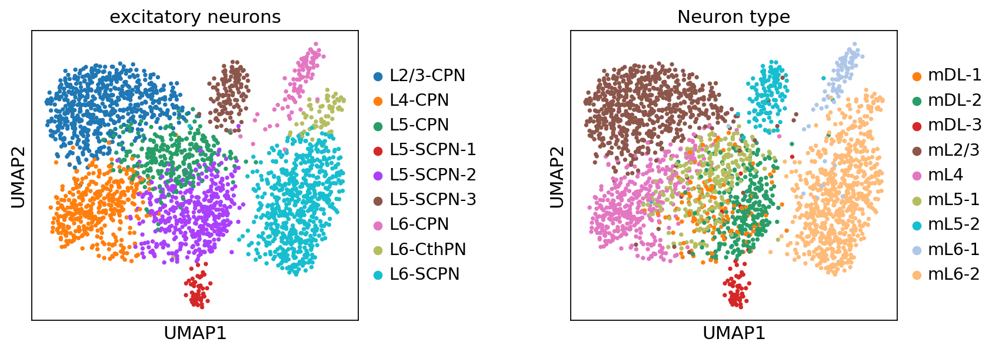

In [125]:
annot = []
for n in adata2.obs['louvain3']:
    if n in ['0']:
        annot.append('L2/3-CPN')
    elif n in ['5,0']:
        annot.append('L6-CthPN')
    elif n in ['5,1', '5,2']:
        annot.append('L6-CPN')
    elif n in ['1']:
        annot.append('L6-SCPN')
    elif n in ['7']:
        annot.append('L5-SCPN-1')
    elif n in ['2']:
        annot.append('L5-SCPN-2')
    elif n in ['4', '8']:
        annot.append('L5-CPN')
    elif n in ['3']:
        annot.append('L4-CPN')
    elif n in ['6']:
        annot.append('L5-SCPN-3')
    else:
        annot.append(n)
        
adata2.obs['excitatory neurons'] = annot        
sc.pl.umap(adata2, color=['excitatory neurons', 'Neuron type'], wspace=0.5)



In [126]:
adata2

AnnData object with n_obs × n_vars = 2734 × 32610
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'louvain', 'Neurod2_1_3337_prCpG_no_input', 'Neurod2_1_3337_prCpG_imputed', 'louvain_promoter', 'louvain_enhancers', 'louvain_promoters', 'louvain_windows', 'louvain_genebodies', 'Neurod2', 'louvain_excitatory', 'Satb2_1_250_prCpG_no_input', 'Satb2_1_250_prCpG_imputed', '4930567H17Rik_1_20920_prCpG_no_input', '4930567H17Rik_1_20920_prCpG_imputed', 'layer', '4930567H17Rik', 'louvain2', 'louvain3', 'excitatory neurons'
    uns: 'Estimated mCG', 'Estimated mCH', 'Neuron type_colors', 'cell_type_colors', 'louvain', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca', 'umap', 'binary_colors', 'louvain_promoter_colors', 'l

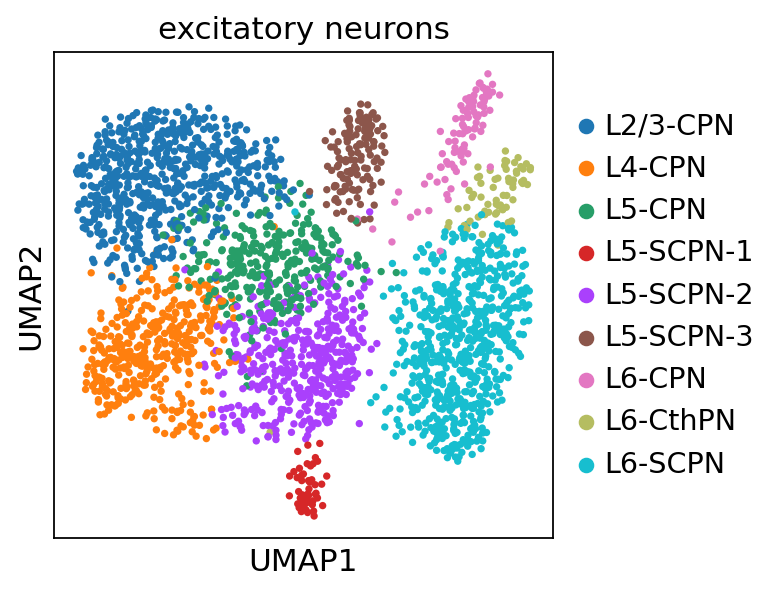

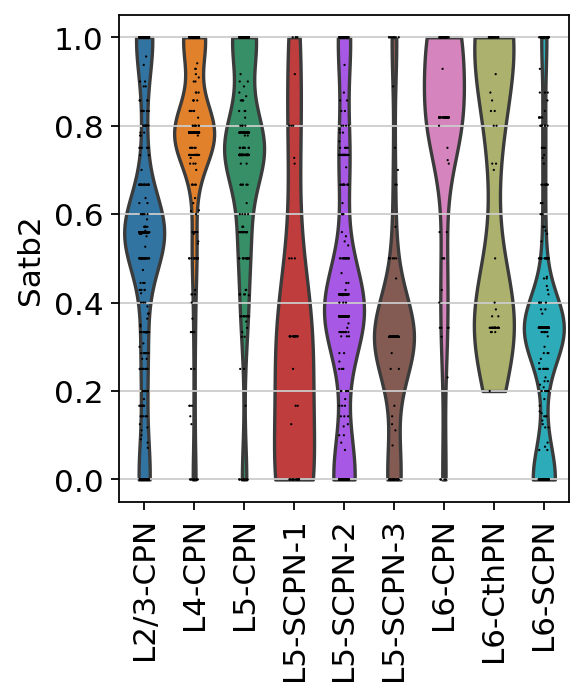

In [139]:
sc.pl.umap(adata2, color=['excitatory neurons'], save='excitatory_neurons.png')
adata2.obs['Satb2'] = adata2.obs['Satb2_1_250_prCpG_imputed'].copy()
#adata2.obs['Satb2'] = adata2.obs['Satb2_1_250_prCpG_no_input'].copy()
sc.pl.violin(adata2,
             keys='Satb2', rotation=90,
            groupby='excitatory neurons', save='Satb2.png')

In [128]:
for name in adata.var_names:
    if "Satb2" in name:
        print(name)
    elif 'Rab4a' in name:
        print(name)
    elif 'Neurod' in name:
        print(name)
    elif '4930567H17Rik' in name:
        print(name)

Neurod1_1_1415_prTATA
4930567H17Rik_1_20920_prCpG
Neurod1_1_10825_prCpG
Neurod2_1_3337_prCpG
Neurod4_1_2216_prCpG
Neurod6_1_15905_prCpG
Rab4a_1_19378_prCpG
Satb2_1_250_prCpG
Neurod1_1_4965_prCG


In [129]:
marker_genes = []
for name in adata.var_names:
    if "Rorb" in name:
        print(name)
        marker_genes.append(name)
    elif 'Cux1' in name:
        print(name)
        marker_genes.append(name)
    elif 'Bcl6' in name:
        print(name)
        marker_genes.append(name)
    elif 'Slc38a8' in name:
        print(name)
        marker_genes.append(name)
    elif 'Cep44' in name:
        print(name)
        marker_genes.append(name)
    elif 'Spns1' in name:
        print(name)
        marker_genes.append(name)
        

Rorb_1_1812_prCCAAT
Spns1_1_3363_prCCAAT
Bcl6b_1_348_prTATA
Slc38a8_1_2570_prTATA
Bcl6_1_7391_prCpG
Bcl6b_1_2854_prCpG
Cux1_1_15319_prCpG
Cux1_2_15318_prCpG
Cux1_3_15317_prCpG
Cux1_4_15316_prCpG
Rorb_1_9800_prCpG
Rorb_2_9799_prCpG
Spns1_1_18015_prCpG
Bcl6b_1_1297_prCG
Rorb_1_4495_prCG
Slc38a8_1_8997_prCG


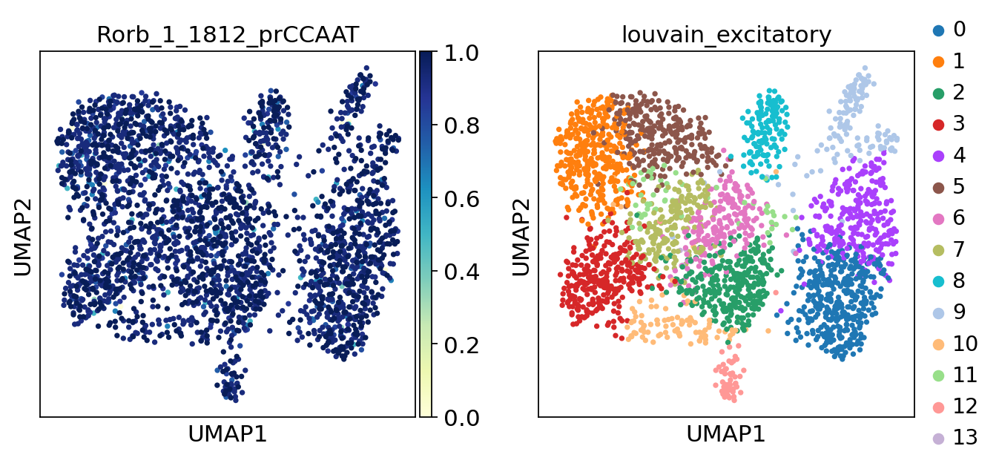

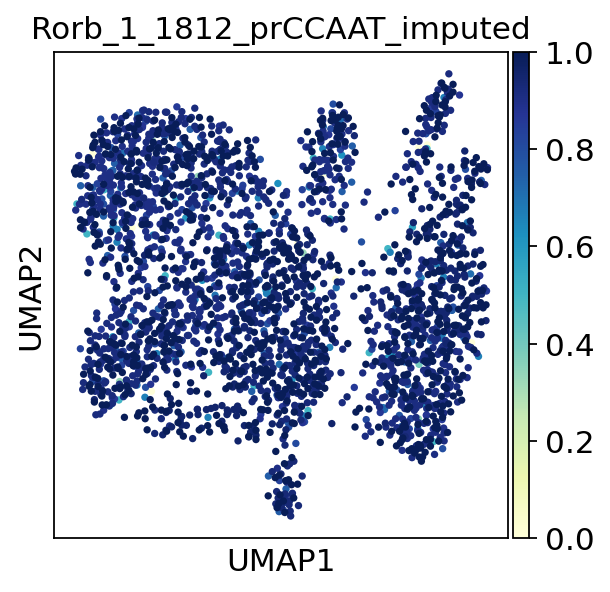

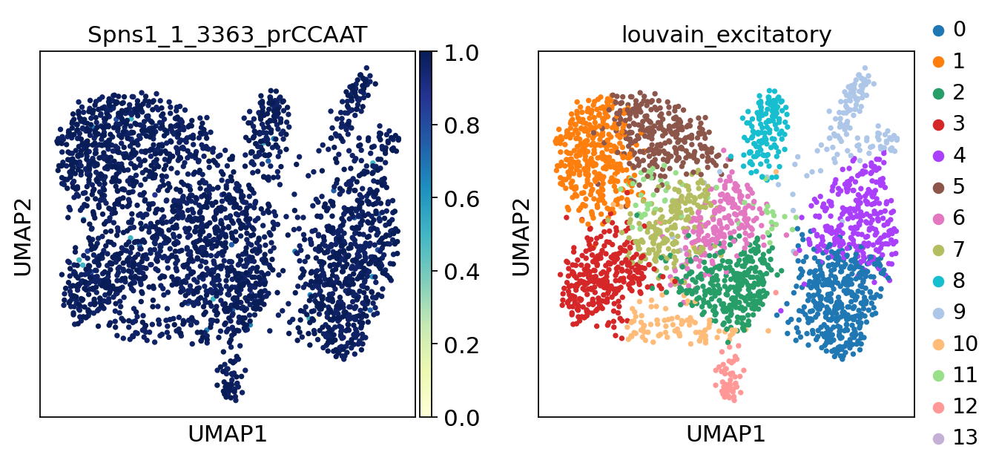

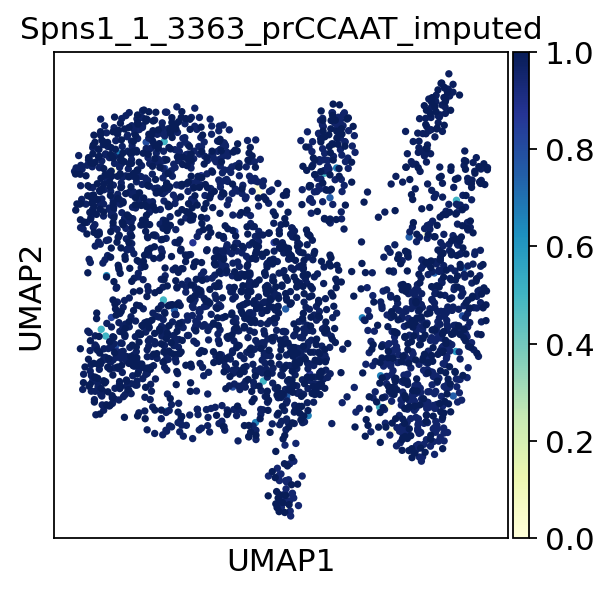

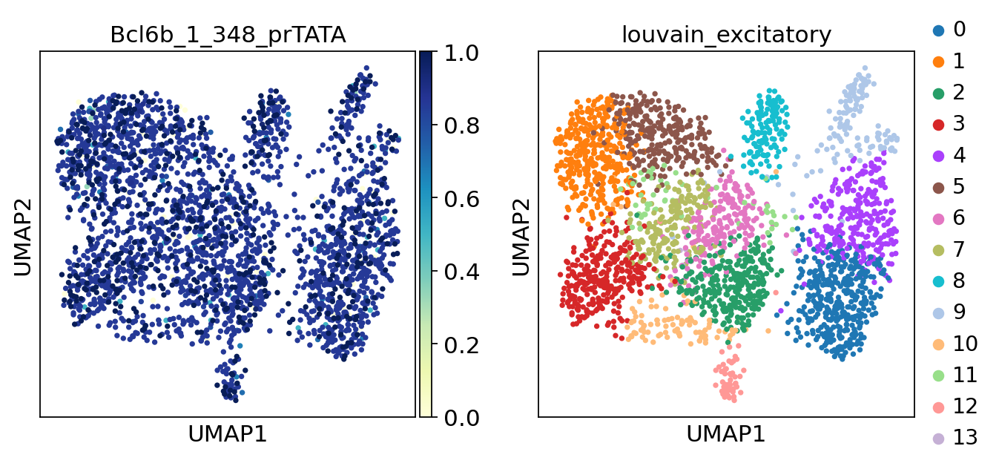

...

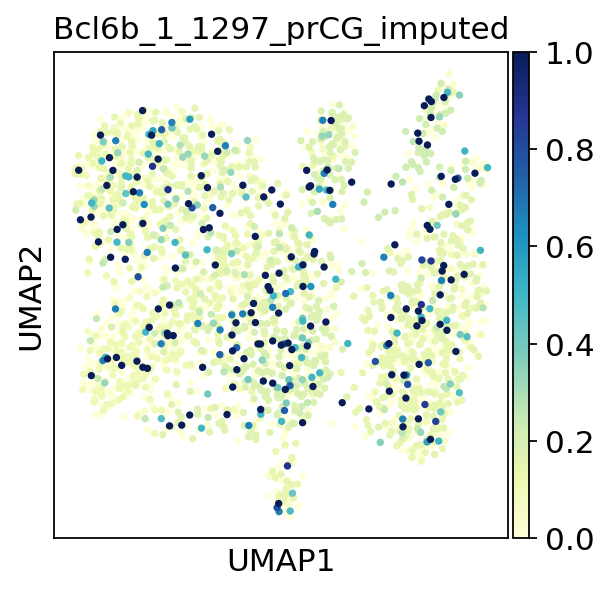

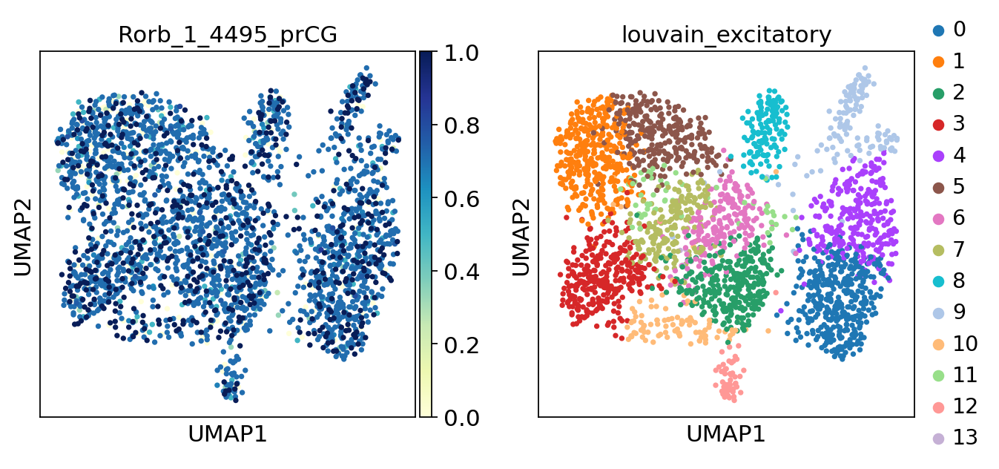

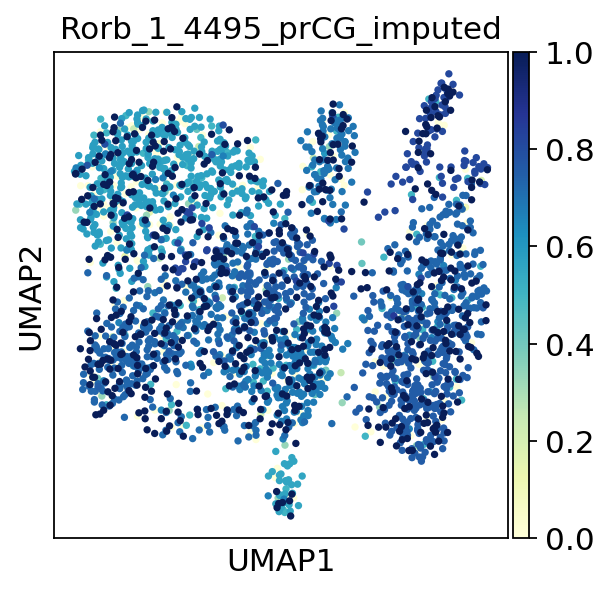

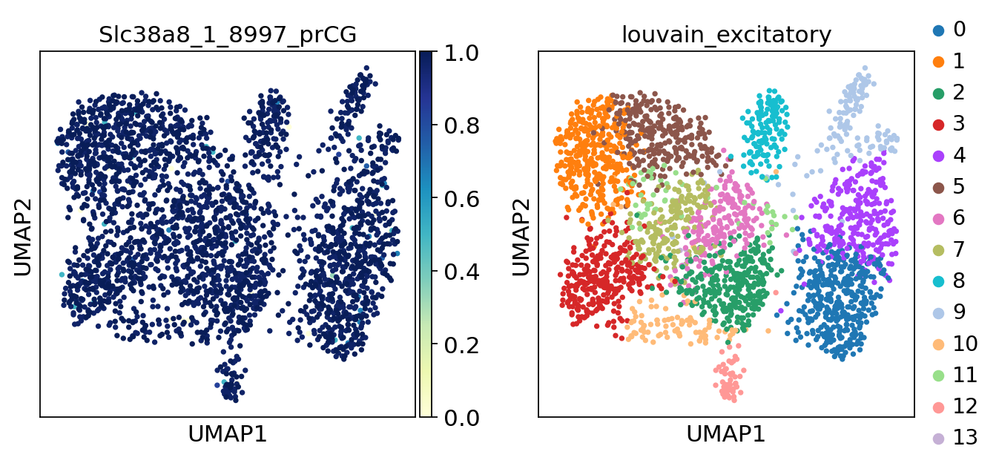

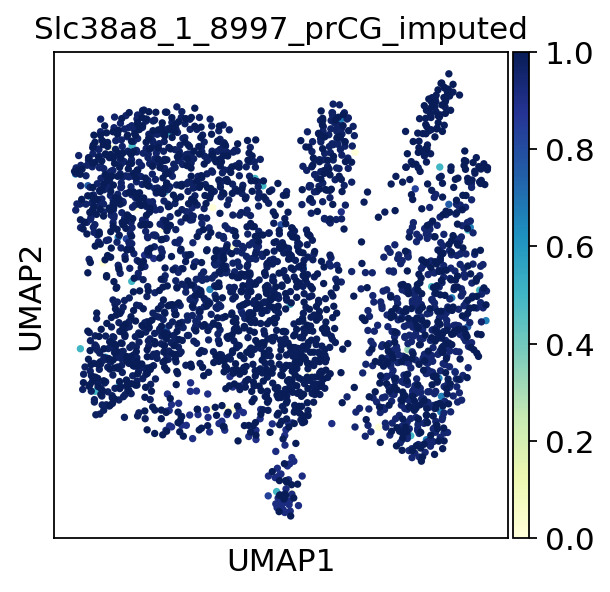

In [130]:
for name in marker_genes:
    imputation(adata2, name,'louvain_excitatory')
    sc.pl.umap(adata2, color=[name, 'louvain_excitatory'])
    sc.pl.umap(adata2, color=[name+'_imputed'], save=name+'.png')

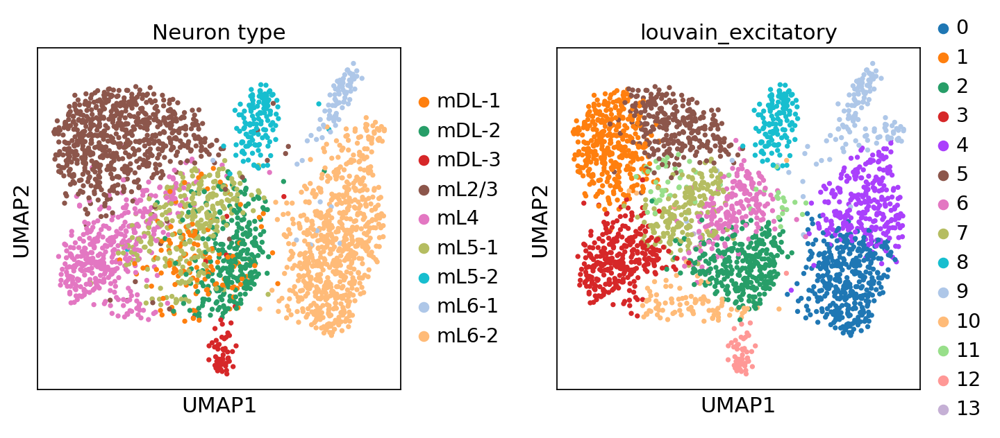

In [131]:
sc.pl.umap(adata2, color=['Neuron type', 'louvain_excitatory'], wspace=0.3)

### inhibitory neurons

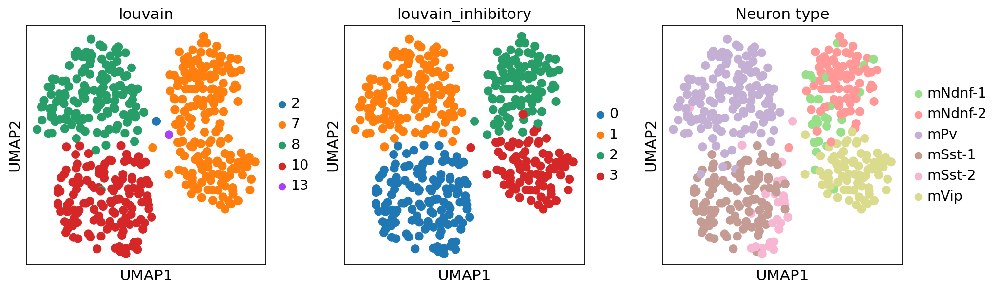

In [132]:
adata1 = adata[adata.obs['binary']=='inhibitory',:].copy()
adata1 = adata1[adata1.obs['cell_type']!='mIn-1',:].copy()
adata1

epi.pp.lazy(adata1)
sc.tl.louvain(adata1, key_added='louvain_inhibitory')
sc.pl.umap(adata1, color=['louvain', 'louvain_inhibitory', 'Neuron type'])

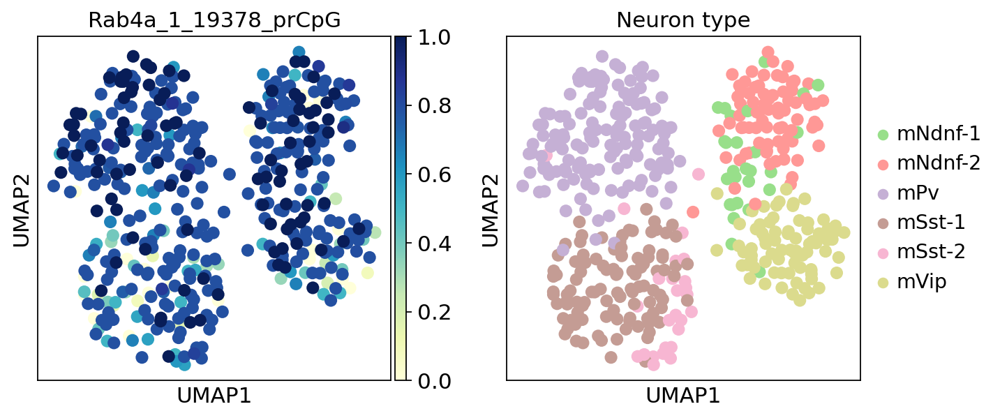

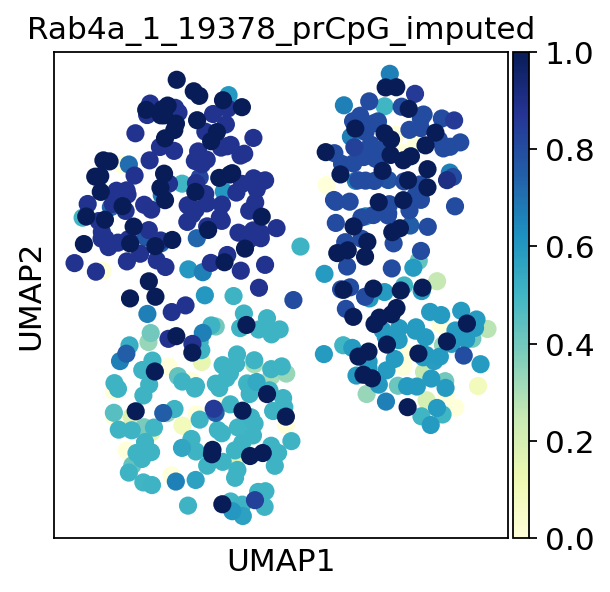

AnnData object with n_obs × n_vars = 449 × 32610
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'louvain', 'Neurod2_1_3337_prCpG_no_input', 'Neurod2_1_3337_prCpG_imputed', 'louvain_promoter', 'louvain_enhancers', 'louvain_promoters', 'louvain_windows', 'louvain_genebodies', 'Neurod2', 'louvain_inhibitory', 'Rab4a_1_19378_prCpG_no_input', 'Rab4a_1_19378_prCpG_imputed'
    uns: 'Estimated mCG', 'Estimated mCH', 'Neuron type_colors', 'cell_type_colors', 'louvain', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca', 'umap', 'binary_colors', 'louvain_promoter_colors', 'louvain_promoters_colors', 'louvain_colors', 'louvain_inhibitory_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances',

In [133]:
imputation(adata1, 'Rab4a_1_19378_prCpG','cell_type')
sc.pl.umap(adata1, color=['Rab4a_1_19378_prCpG', 'Neuron type'])
sc.pl.umap(adata1, color=['Rab4a_1_19378_prCpG_imputed'], save='Rab4a.png')
adata1

In [134]:
annot = []
for n in adata1.obs['cell_type']:
    if n in ['mSst', 'mPv']:
        annot.append('MGE')
    else:
        annot.append('CGE')
adata1.obs['ganglionic extension'] = annot

annot = []
for n in adata1.obs['cell_type']:
    if n in ['mPv']:
        annot.append('Pvalb')
    elif n in ['mSst']:
        annot.append('Sst')
    elif n in ['mNdnf']:
        annot.append('Ndnf')
    else:
        annot.append('Vip')
adata1.obs['cell_name'] = annot

... storing 'ganglionic extension' as categorical
... storing 'cell_name' as categorical


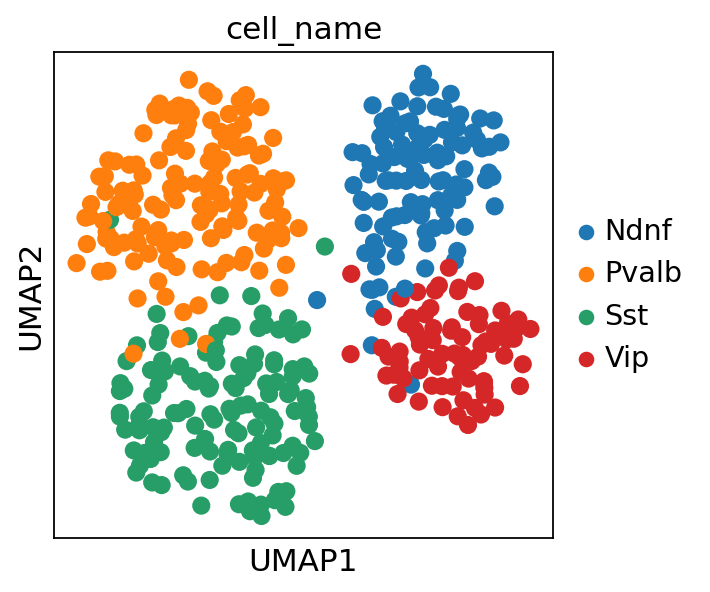

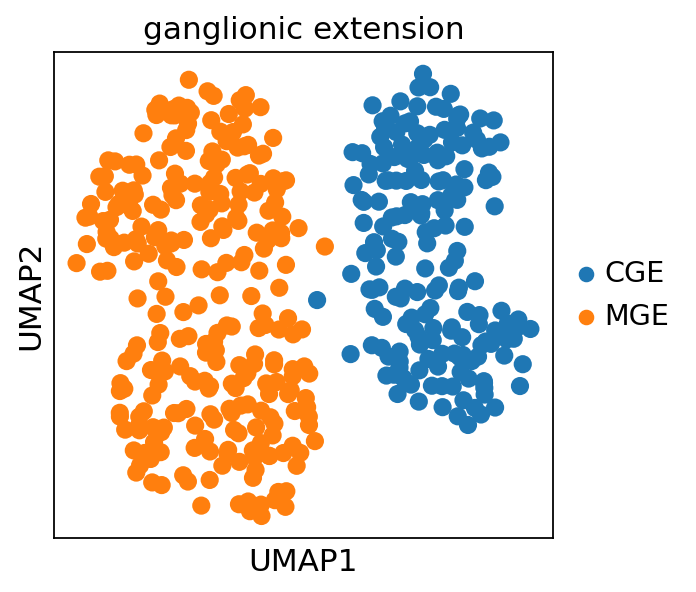

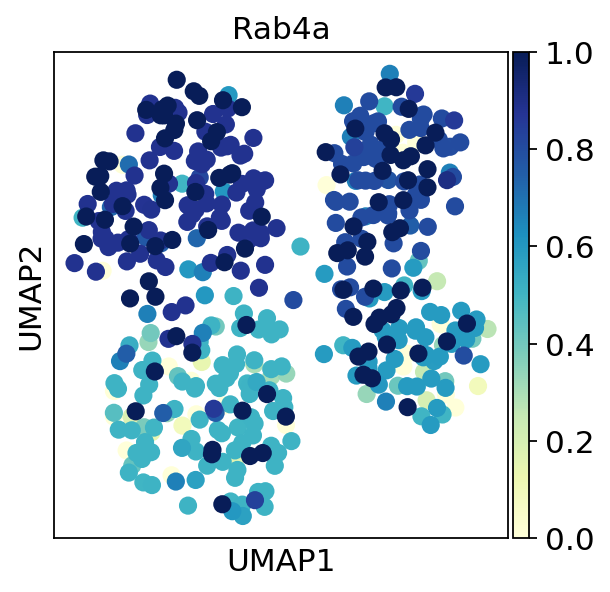

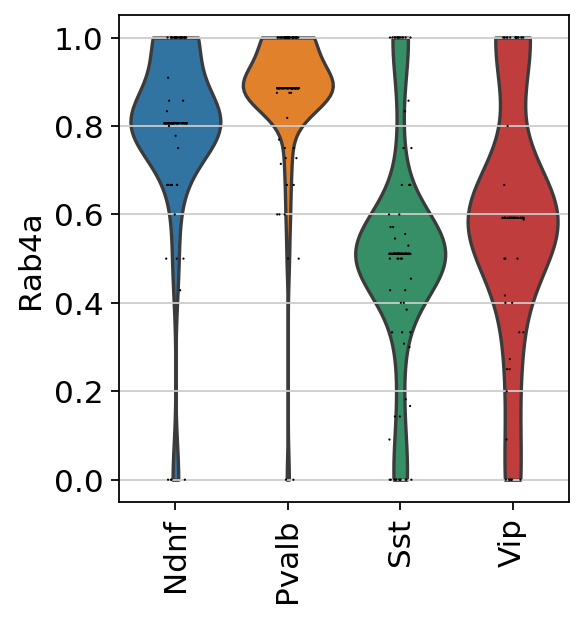

In [135]:
sc.pl.umap(adata1, color=['cell_name'], save='inhibitory_neurons_clusters_1.png')
sc.pl.umap(adata1, color=['ganglionic extension'], save='inhibitory_neurons_clusters_2.png')
sc.pl.umap(adata1, color=['Rab4a_1_19378_prCpG_imputed'], title='Rab4a', save='inhibtory_Rab4a.png')

adata1.obs['Rab4a'] = adata1.obs['Rab4a_1_19378_prCpG_imputed'].copy()
sc.pl.violin(adata1,
             keys='Rab4a', rotation=90,
            groupby='cell_name', save='Rab4a.png')

# Enhancers

In [85]:
DATADIR = ''
adata = ad.read(DATADIR+'enhancer_c1_CG_paper.h5ad')
adata

AnnData object with n_obs × n_vars = 3379 × 55017
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary'
    uns: 'imputation', 'omic'

In [86]:
adata2 = epi.pp.imputation_met(adata,
                      number_cell_covered=10,
                      imputation_value='mean',
                      save=None,
                      copy=True)
adata2

AnnData object with n_obs × n_vars = 3379 × 54932
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'coverage_cells', 'mean_cell_methylation'
    var: 'coverage_feature', 'mean_feature_methylation'
    uns: 'imputation', 'omic'

In [87]:
adata2 = adata2[adata2.obs['coverage_cells'] >10000,:].copy()
adata2

AnnData object with n_obs × n_vars = 3346 × 54932
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'coverage_cells', 'mean_cell_methylation'
    var: 'coverage_feature', 'mean_feature_methylation'
    uns: 'imputation', 'omic'

In [88]:
adata2.uns['imputation']

'no_imputation'

In [89]:
adata2.uns['imputation'] = 'imputation_value=mean, number_cell_covered=10'

In [90]:
adata2

AnnData object with n_obs × n_vars = 3346 × 54932
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'coverage_cells', 'mean_cell_methylation'
    var: 'coverage_feature', 'mean_feature_methylation'
    uns: 'imputation', 'omic'

In [91]:
sc.pp.pca(adata2, n_comps=100)

In [92]:
adata2.obs['mCCC/CCC'] = [float('.'.join(x.split(','))) for x in adata2.obs['mCCC/CCC']]
adata2.obs['mCG/CG'] = [float('.'.join(x.split(','))) for x in adata2.obs['mCG/CG']]
adata2.obs['mCH/CH'] = [float('.'.join(x.split(','))) for x in adata2.obs['mCH/CH']]

adata2.obs['Total reads'] = [int(x) for x in adata2.obs['Total reads']]
adata2.obs['Mapped reads'] = [int(x) for x in adata2.obs['Mapped reads']]
adata2.obs['Filtered reads'] = [int(x) for x in adata2.obs['Filtered reads']]

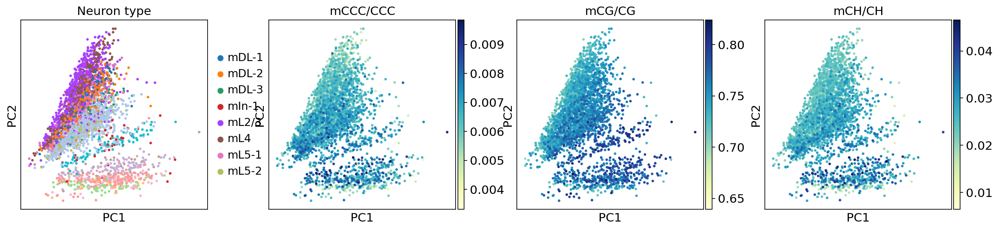

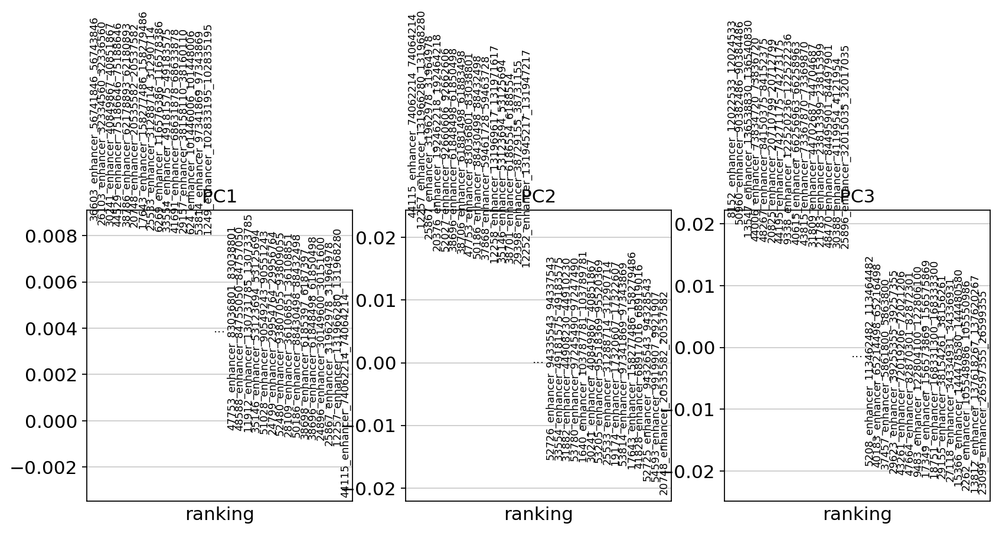

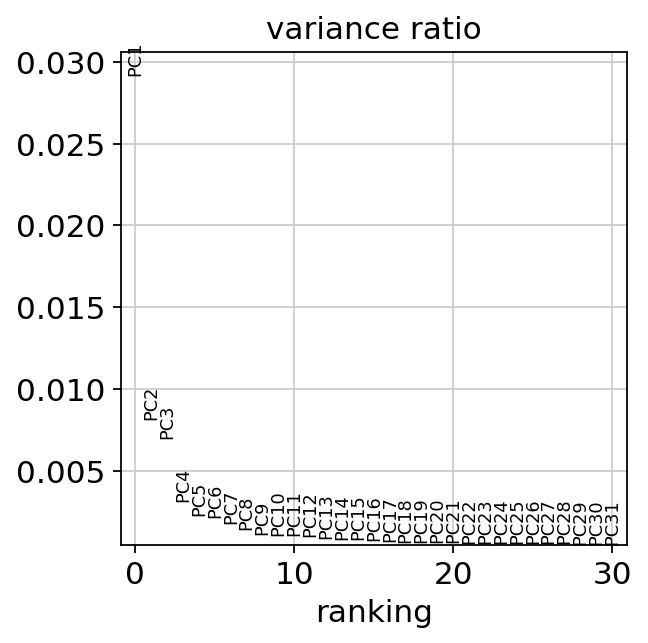

In [93]:
sc.pl.pca_overview(adata2, color=['Neuron type', 'mCCC/CCC', 'mCG/CG', 'mCH/CH' ])

In [94]:
adata2

AnnData object with n_obs × n_vars = 3346 × 54932
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'coverage_cells', 'mean_cell_methylation'
    var: 'coverage_feature', 'mean_feature_methylation'
    uns: 'imputation', 'omic', 'pca', 'Neuron type_colors'
    obsm: 'X_pca'
    varm: 'PCs'

In [95]:
sc.pp.neighbors(adata2, n_neighbors=15, n_pcs=50)
sc.tl.umap(adata2)

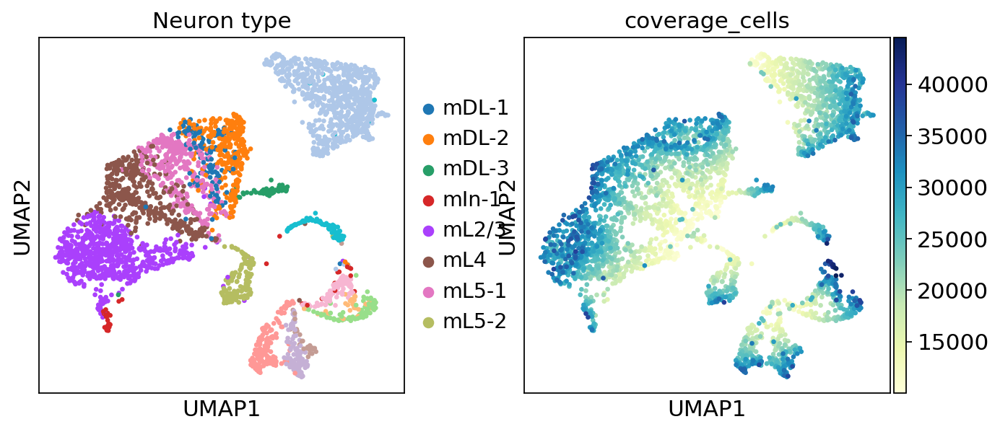

In [96]:
#sc.pl.umap(adata2, color=['Neuron type', 'mCG/CG'])
sc.pl.umap(adata2, color=['Neuron type', 'coverage_cells'])

In [97]:
sc.pp.regress_out(adata2, 'coverage_cells')

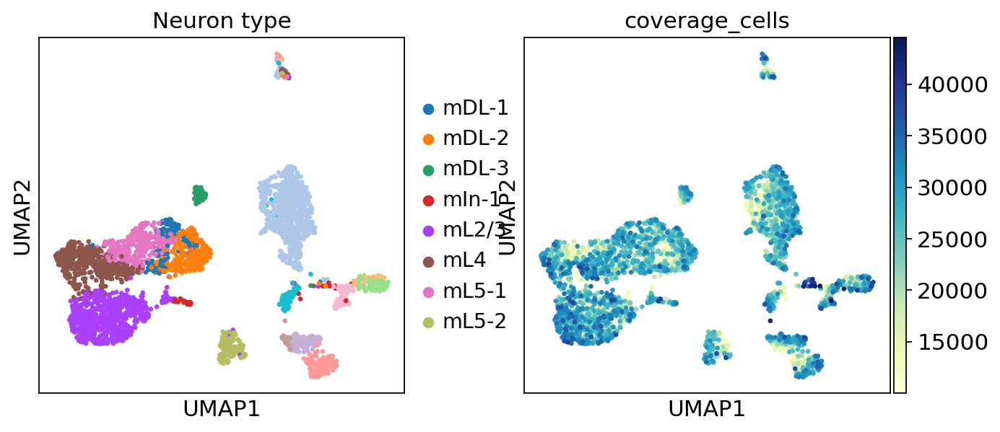

In [98]:
sc.pp.pca(adata2)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)
sc.pl.umap(adata2, color=['Neuron type', 'coverage_cells'])

In [99]:
sc.tl.louvain(adata2)

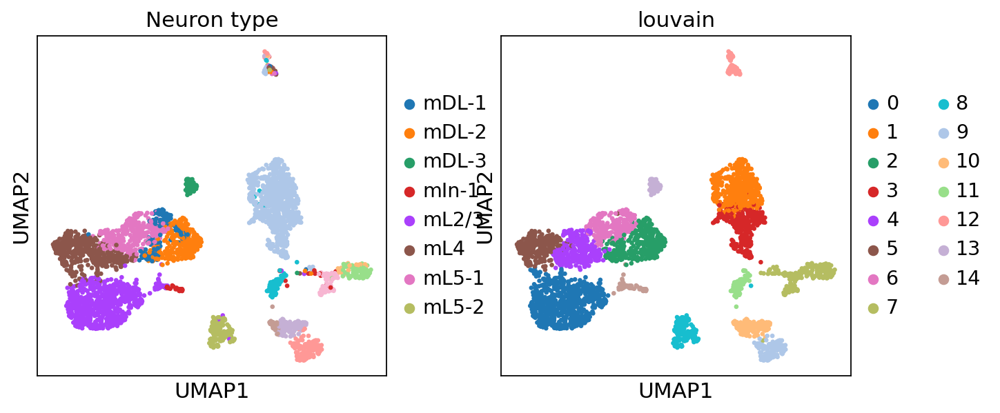

In [100]:
sc.pl.umap(adata2, color=['Neuron type', 'louvain'])

In [101]:
adata2 = adata2[adata2.obs['louvain']!='12',:].copy()
adata2

AnnData object with n_obs × n_vars = 3288 × 54932
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'coverage_cells', 'mean_cell_methylation', 'louvain'
    var: 'coverage_feature', 'mean_feature_methylation'
    uns: 'imputation', 'omic', 'pca', 'Neuron type_colors', 'neighbors', 'umap', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

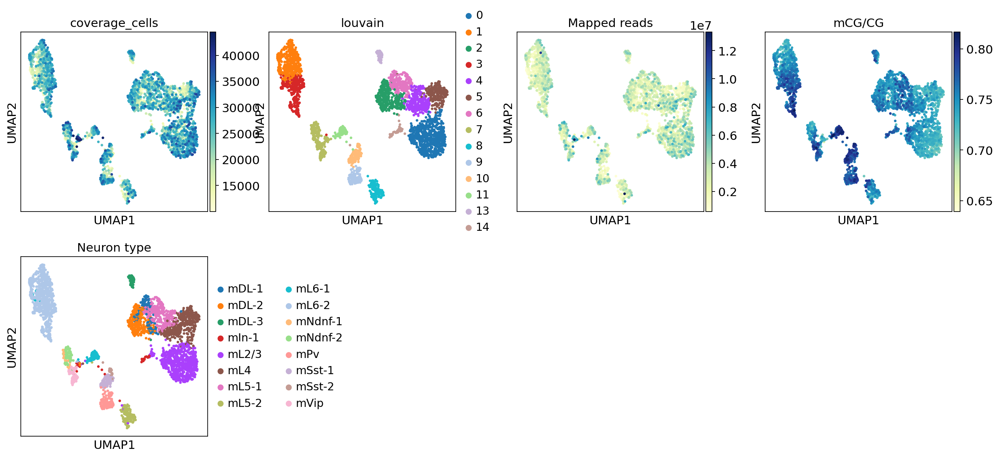

In [102]:
sc.pp.pca(adata2)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)
sc.pl.umap(adata2,
           color=['coverage_cells', 'louvain',
                  'Mapped reads', 'mCG/CG',
                  'Neuron type'], 
          save='_enhancers_CG.png')

In [103]:
sc.tl.louvain(adata2)

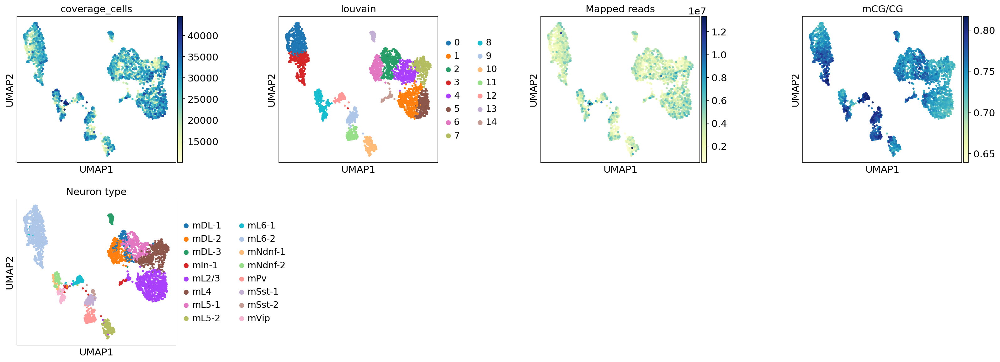

In [104]:
sc.pl.umap(adata2,
           color=['coverage_cells', 'louvain',
                  'Mapped reads', 'mCG/CG',
                  'Neuron type'], wspace=0.5,
          save='_enhancers_CG.png')

In [105]:
adata2

AnnData object with n_obs × n_vars = 3288 × 54932
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'coverage_cells', 'mean_cell_methylation', 'louvain'
    var: 'coverage_feature', 'mean_feature_methylation'
    uns: 'imputation', 'omic', 'pca', 'Neuron type_colors', 'neighbors', 'umap', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

<Figure size 800x800 with 0 Axes>

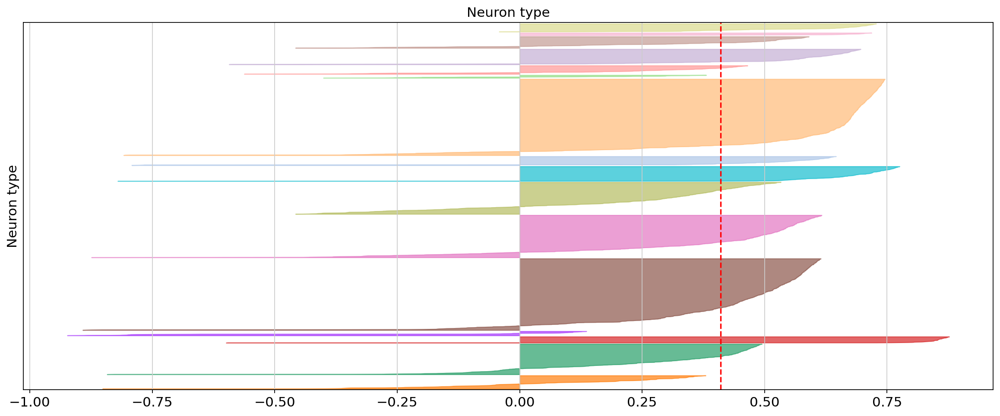

0.41030416


()

In [106]:
silhouette_plot = 'silhouette_enhancers_umap_neuron_type_CG.png'
plt.figure(figsize=(10,10))
epi.pl.silhouette_tot(adata2,
                      'Neuron type',
                      value='X_umap',
                      palette=['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
                      name_cluster=False,
                     save=silhouette_plot)





In [ ]:
silhouette_plot = 'silhouette_enhancers_umap_neuron_type_CG.png'
epi.pl.silhouette_tot(adata2, 'Neuron type', value='X_umap', palette=adata2.uns['louvain_colors'], save=silhouette_plot)

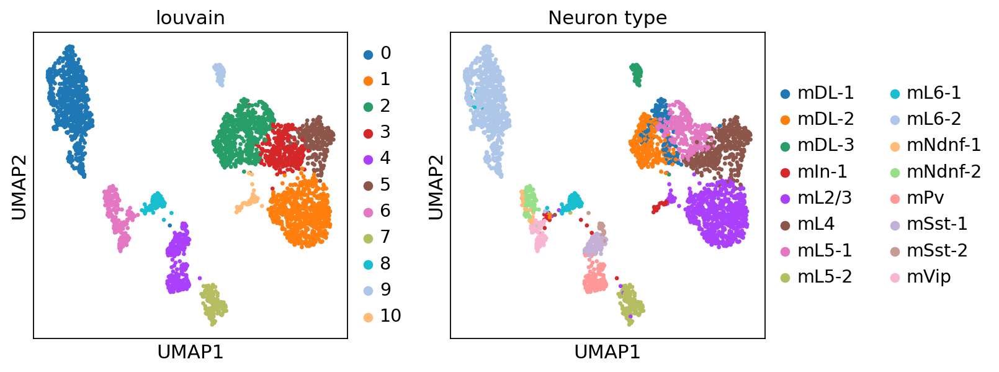

In [36]:
sc.tl.louvain(adata2, resolution=0.7)
sc.pl.umap(adata2, color=['louvain', 'Neuron type'])

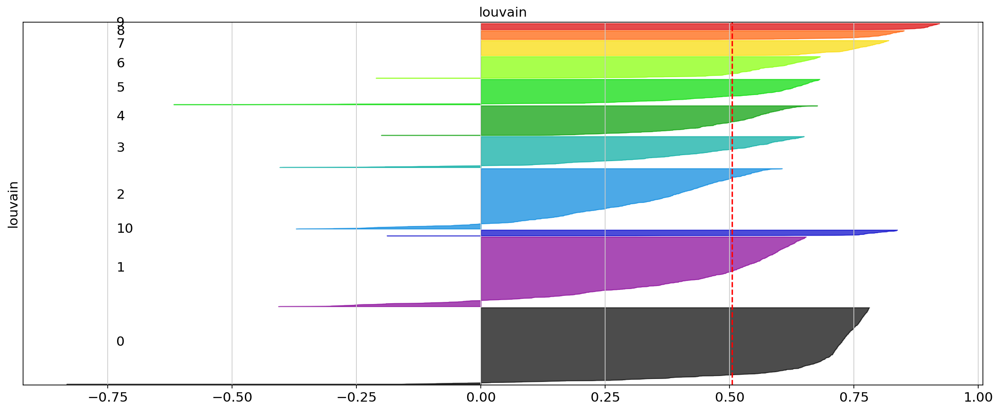

0.50450385


()

In [37]:
epi.pl.silhouette_tot(adata2, 'louvain', value='X_umap')

In [38]:
adata2.write('processed_enhancers.h5ad')

In [ ]:
#adata_enhancers = ad.read('processed_enhancers.h5ad')
#adata_enhancers

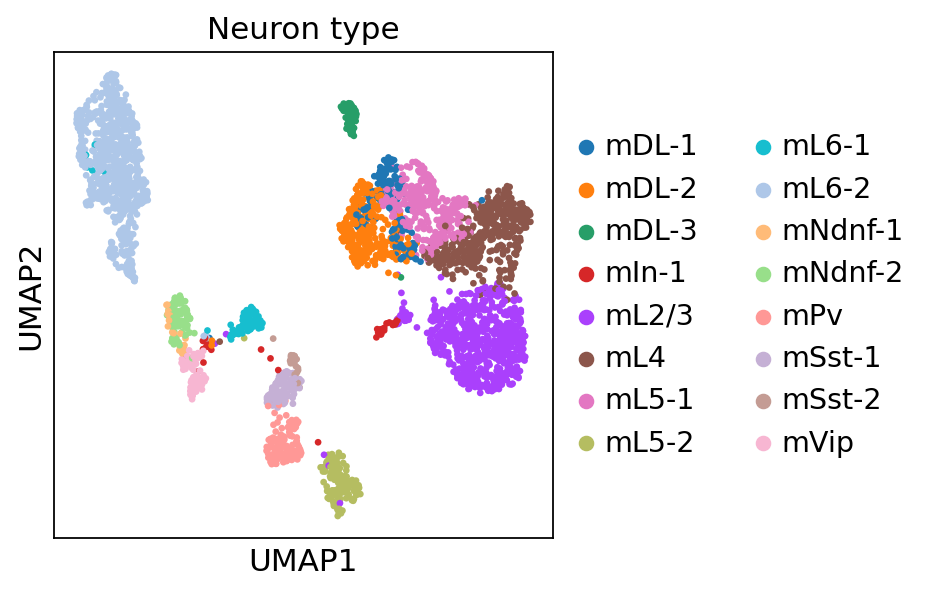

In [39]:
sc.pl.umap(adata2,
           color=['Neuron type'], wspace=0.5,
          save='_enhancers_CG_old_colors.png')

In [40]:
adata2.uns["Neuron type_colors"] = ['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d']

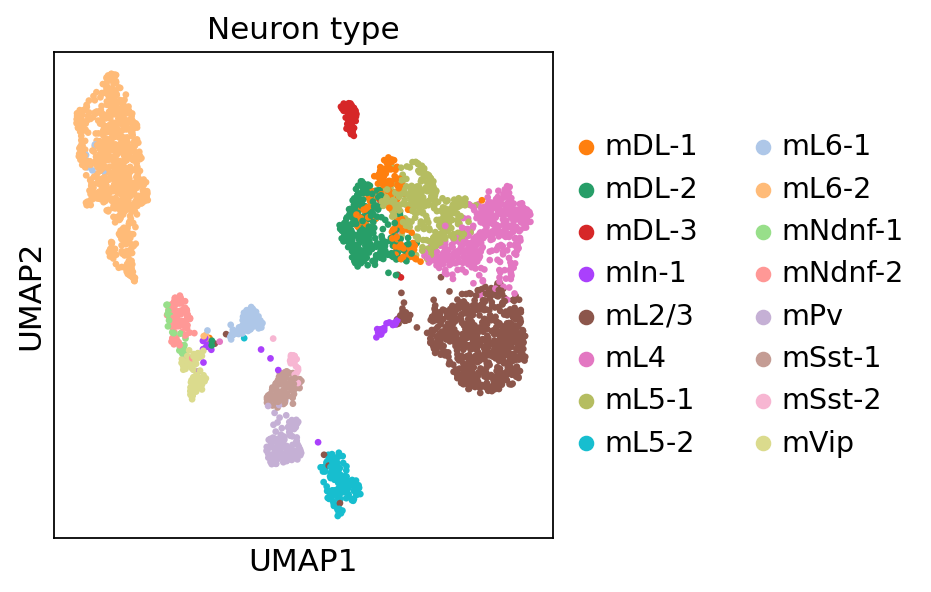

In [56]:
sc.pl.umap(adata2,
           color=['Neuron type'], wspace=0.5,
          save='_enhancers_CG_new_colors.png')

# Genebodies

In [120]:
DATADIR = ''
adata = ad.read(DATADIR+'mousecells_genebodies_c1_CG_1000cells.h5ad')
adata


This is where adjacency matrices should go now.

This is where adjacency matrices should go now.


AnnData object with n_obs × n_vars = 3232 × 26947
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary'
    uns: 'Estimated mCG', 'Estimated mCH', 'Library pool_colors', 'Neuron type_colors', 'cell_type_colors', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [121]:
adata = adata[adata.obs['Mapped reads']!='NA',:].copy()
adata.obs['Mapped reads'] = [int(x) for x in adata.obs['Mapped reads']]
adata

AnnData object with n_obs × n_vars = 3223 × 26947
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary'
    uns: 'Estimated mCG', 'Estimated mCH', 'Library pool_colors', 'Neuron type_colors', 'cell_type_colors', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

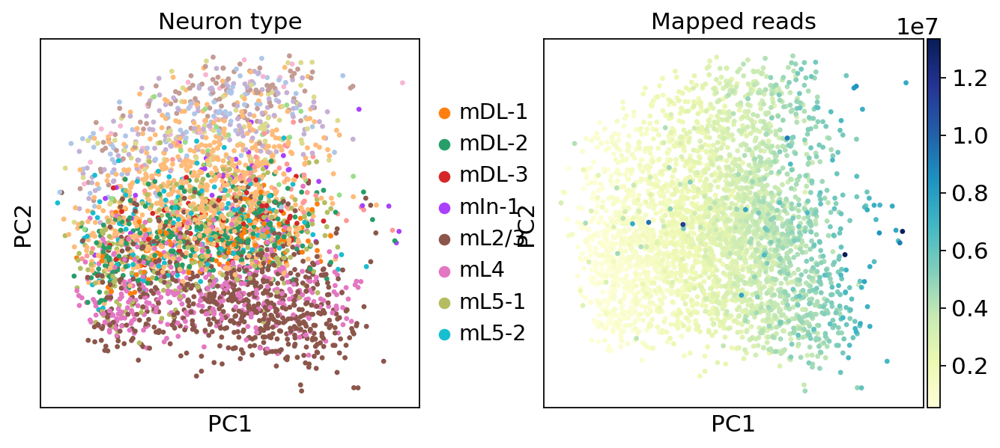

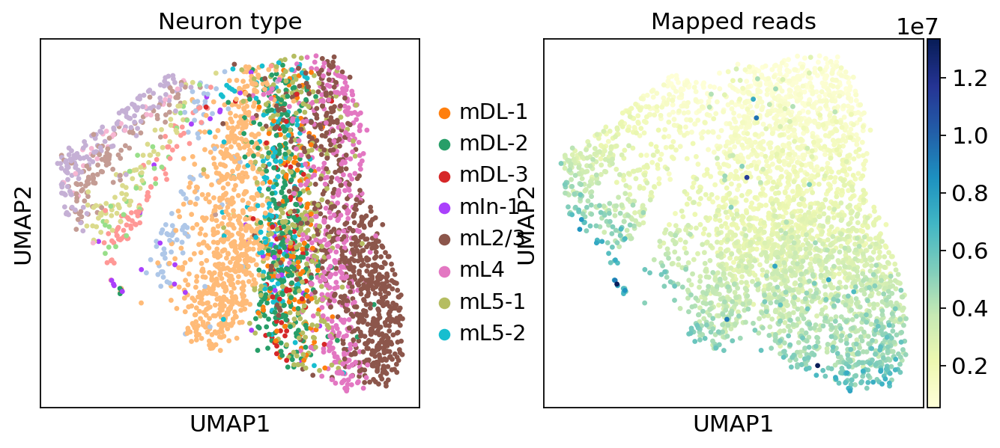

In [122]:
sc.pl.pca(adata, color=['Neuron type', 'Mapped reads'])
sc.pl.umap(adata, color=['Neuron type', 'Mapped reads'])

In [123]:
sc.pp.regress_out(adata, 'Mapped reads')

In [124]:
epi.pp.lazy(adata)

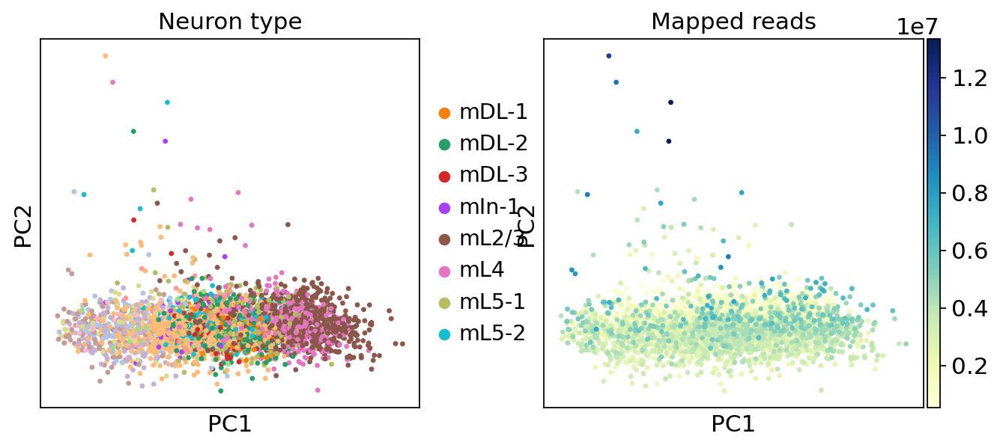

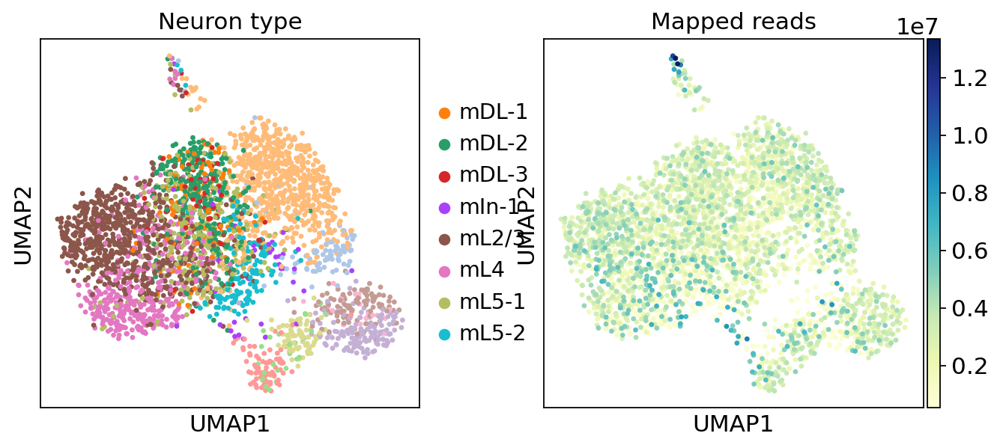

In [125]:
sc.pl.pca(adata, color=['Neuron type', 'Mapped reads'])
sc.pl.umap(adata, color=['Neuron type', 'Mapped reads'])

In [126]:
sc.tl.louvain(adata)

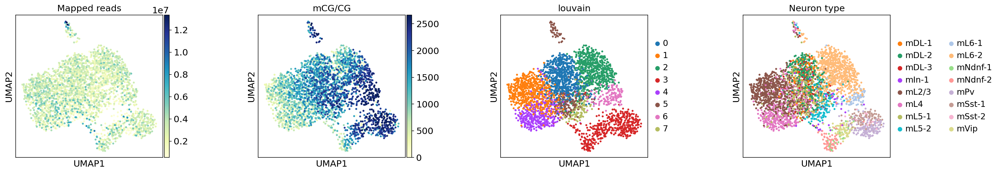

In [127]:
sc.pl.umap(adata,
           color=['Mapped reads','mCG/CG', 'louvain', 'Neuron type'],
           wspace=0.5,
           save='umap_genebodies_CG.png')

In [128]:
adata.uns["Neuron type_colors"] = ['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d']

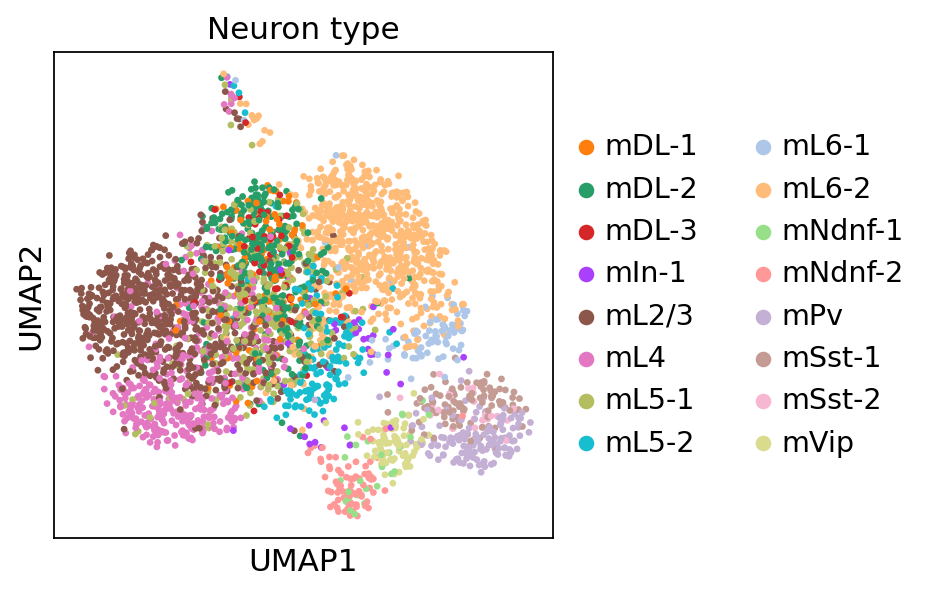

In [129]:
sc.pl.umap(adata,
           color=['Neuron type'],
           wspace=0.5,
           save='umap_genebodies_CG_nwe_colors.png')

In [130]:
adata = adata[adata.obs['louvain'] != '5',:].copy()
adata

AnnData object with n_obs × n_vars = 3019 × 26947
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary', 'louvain'
    uns: 'Estimated mCG', 'Estimated mCH', 'Library pool_colors', 'Neuron type_colors', 'cell_type_colors', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca', 'umap', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

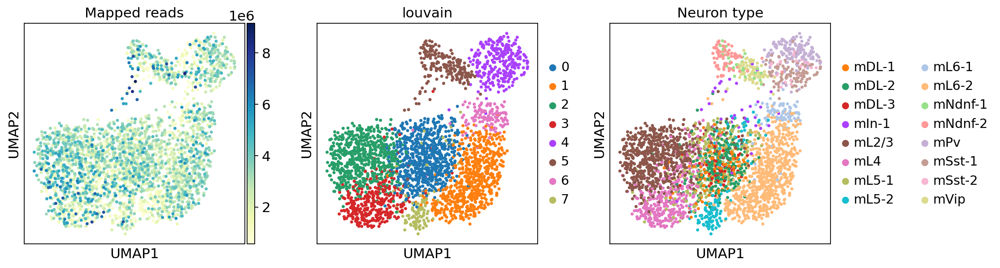

In [131]:
epi.pp.lazy(adata)
sc.tl.louvain(adata)
sc.pl.umap(adata, color=['Mapped reads', 'louvain', 'Neuron type'])

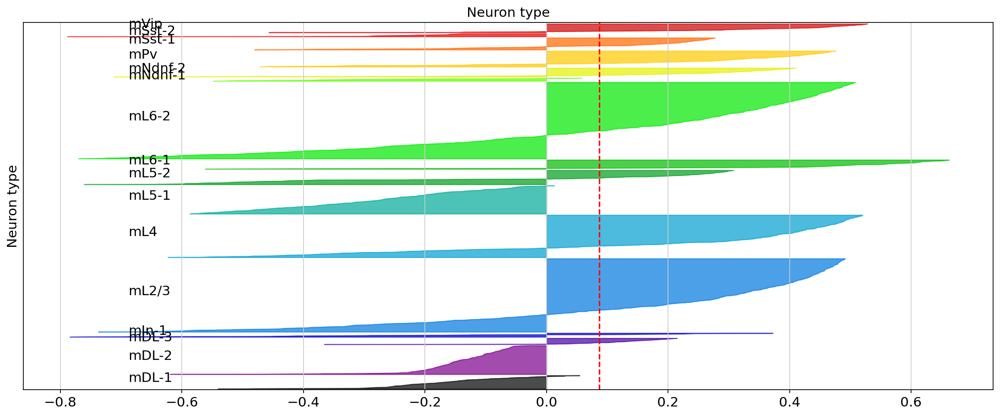

0.08675688


()

In [63]:
epi.pl.silhouette_tot(adata, 'Neuron type', value='X_umap', save='genebodies_silhouette_CG_UMAP.png')

<Figure size 800x800 with 0 Axes>

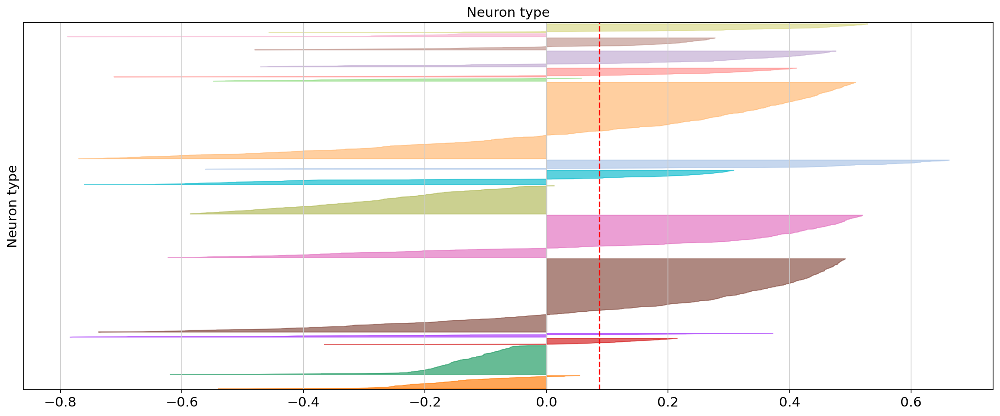

0.08675688


()

In [64]:
silhouette_plot = 'genebodies_silhouette_CG_UMAP.png'
plt.figure(figsize=(10,10))
epi.pl.silhouette_tot(adata,
                      'Neuron type',
                      value='X_umap',
                      palette=['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
                      name_cluster=False,
                     save=silhouette_plot)

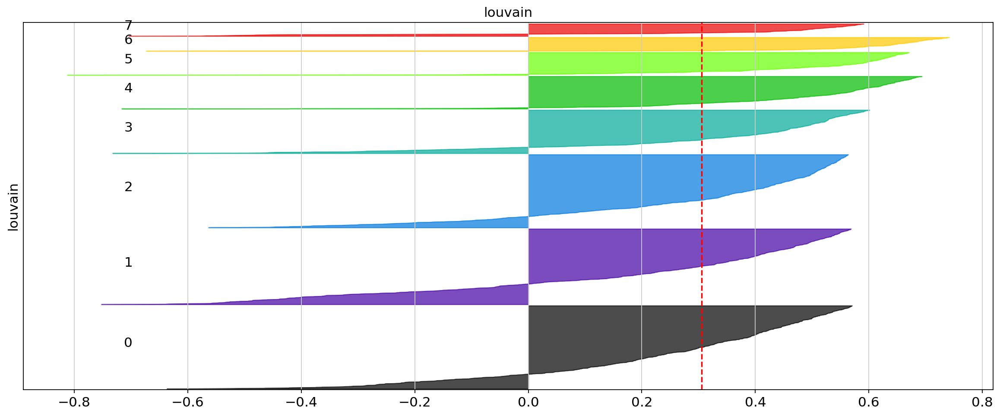

0.3050138


()

In [42]:
epi.pl.silhouette_tot(adata, 'louvain', value='X_umap')

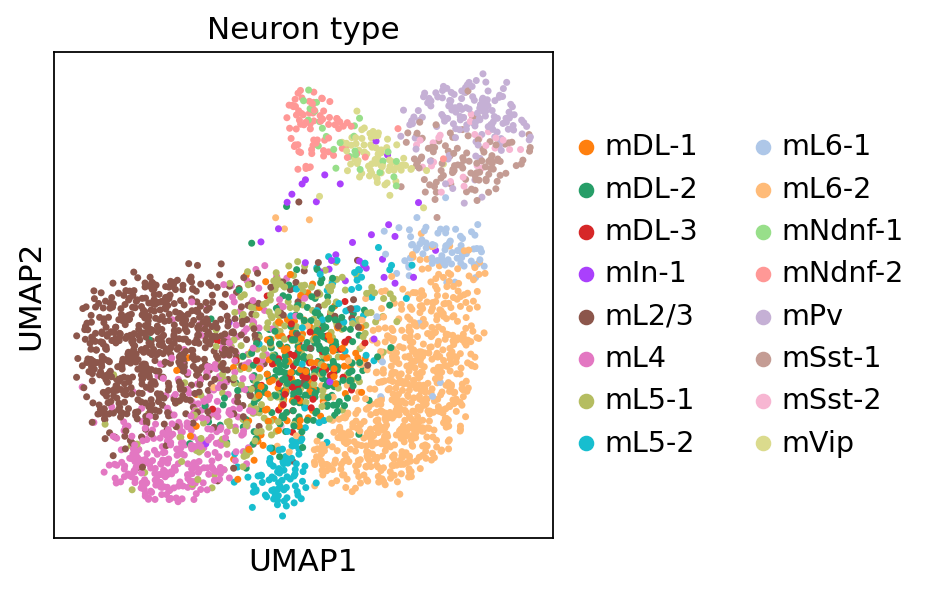

In [43]:
sc.pl.umap(adata,
           color=['Neuron type'],
           wspace=0.5,
           save='umap_genebodies_CG_nwe_colors.png')

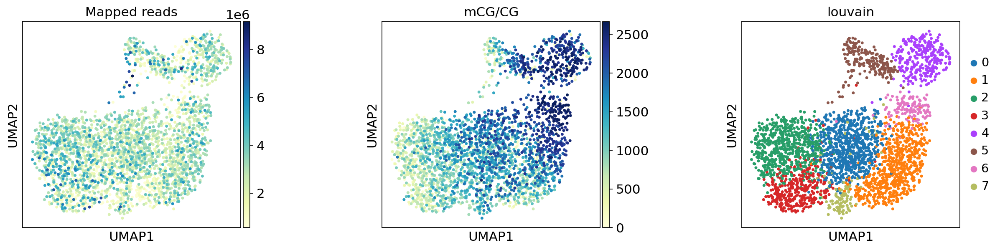

In [44]:
sc.pl.umap(adata,
           color=['Mapped reads','mCG/CG', 'louvain'],
           wspace=0.5,
           save='umap_genebodies_CG_nwe_colos2.png')

In [45]:
adata_genebodies = adata.copy()

In [132]:
adata.write('genebodies_processsed.h5ad')

# Windows

In [133]:
DATADIR = '/mnt/znas/icb_zstore01/groups/ce01/workspace/project_anna/methylation_resubmission/'
adata = ad.read(DATADIR+'mousecells_100kb_bins_c1_CG_1000cells.h5ad')
adata

AnnData object with n_obs × n_vars = 3388 × 6729

In [134]:
adata.obs_names

Index(['allc_Pool_1000_AD002_indexed_qual30.tsv',
       'allc_nuclei_600_S147_L006_qual30.tsv',
       'allc_nuclei_599_S146_L006_qual30.tsv',
       'allc_nuclei_598_S145_L006_qual30.tsv',
       'allc_nuclei_597_S144_L006_qual30.tsv',
       'allc_nuclei_596_S143_L006_qual30.tsv',
       'allc_nuclei_595_S142_L006_qual30.tsv',
       'allc_nuclei_594_S141_L006_qual30.tsv',
       'allc_nuclei_592_S139_L006_qual30.tsv',
       'allc_nuclei_591_S138_L006_qual30.tsv',
       ...
       'allc_Pool_837_AD002_indexed_qual30.tsv',
       'allc_Pool_837_AD006_indexed_qual30.tsv',
       'allc_Pool_838_AD002_indexed_qual30.tsv',
       'allc_Pool_838_AD006_indexed_qual30.tsv',
       'allc_Pool_839_AD002_indexed_qual30.tsv',
       'allc_Pool_839_AD006_indexed_qual30.tsv',
       'allc_Pool_83_AD002_indexed_qual30.tsv',
       'allc_Pool_83_AD006_indexed_qual30.tsv',
       'allc_Pool_995_AD002_indexed_qual30.tsv',
       'allc_nuclei-319_S59_L002_qual30_1.tsv'],
      dtype='object', name='

In [135]:
DATADIR = ''
adata2 = ad.read(DATADIR+'mousecells_genebodies_c1_CG_1000cells.h5ad')
adata2


This is where adjacency matrices should go now.

This is where adjacency matrices should go now.


AnnData object with n_obs × n_vars = 3232 × 26947
    obs: 'cell_type', 'Library pool', 'Index i5', 'Index i7', 'i5 sequence', 'i7 sequence', 'random primer index', 'random primer index sequence', 'Total reads', 'Mapped reads', 'Filtered reads', 'mCCC/CCC', 'mCG/CG', 'mCH/CH', 'Estimated mCG/CG', 'Estimated mCH/CH', 'Neuron type', 'tSNE x coordinate', 'tSNE y coordinate\n', 'binary'
    uns: 'Estimated mCG', 'Estimated mCH', 'Library pool_colors', 'Neuron type_colors', 'cell_type_colors', 'mCCC', 'mCG', 'mCH', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [136]:
reference = adata2.obs_names.tolist()
annot = []
for cell_name in adata.obs_names.tolist():
    if cell_name in reference:
        annot.append('keep')
    else:
        annot.append('ignore')
adata.obs['fitler_annot'] = annot
adata = adata[adata.obs['fitler_annot']=='keep',:].copy()
adata

AnnData object with n_obs × n_vars = 3232 × 6729
    obs: 'fitler_annot'

In [137]:
adata2.obs_names.tolist() == adata.obs_names.tolist()

False

In [138]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

In [139]:
dict_cell_type = {}
index1 = 0
for line in adata2.obs_names.tolist():
    dict_cell_type[line] = adata2.obs['Mapped reads'][index1]
    index1 += 1

annot = []
for line in adata.obs_names.tolist():
    if line in dict_cell_type.keys():
        annot.append(dict_cell_type[line])
    else:
        annot.append('NA')
        
adata.obs['Mapped reads'] = annot

In [140]:
dict_cell_type = {}
index1 = 0
for line in adata2.obs_names.tolist():
    dict_cell_type[line] = adata2.obs['Neuron type'][index1]
    index1 += 1

annot = []
for line in adata.obs_names.tolist():
    if line in dict_cell_type.keys():
        annot.append(dict_cell_type[line])
    else:
        annot.append('NA')
        
adata.obs['Neuron type'] = annot

In [141]:
dict_cell_type = {}
index1 = 0
for line in adata2.obs_names.tolist():
    dict_cell_type[line] = adata2.obs['mCG/CG'][index1]
    index1 += 1

annot = []
for line in adata.obs_names.tolist():
    if line in dict_cell_type.keys():
        annot.append(dict_cell_type[line])
    else:
        annot.append('NA')
        
adata.obs['mCG/CG'] = annot

In [142]:
sc.tl.louvain(adata)

In [143]:
adata = adata[adata.obs['Mapped reads']!='NA',:].copy()
adata.obs['Mapped reads'] = [int(x) for x in adata.obs['Mapped reads']]
adata

AnnData object with n_obs × n_vars = 3223 × 6729
    obs: 'fitler_annot', 'Mapped reads', 'Neuron type', 'mCG/CG', 'louvain'
    uns: 'pca', 'neighbors', 'umap', 'louvain'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

... storing 'fitler_annot' as categorical
... storing 'Neuron type' as categorical


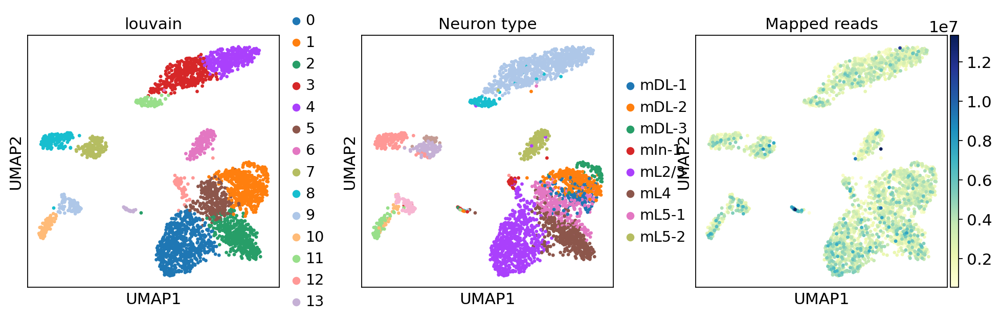

In [144]:
sc.pl.umap(adata, color=['louvain', 'Neuron type', 'Mapped reads'])

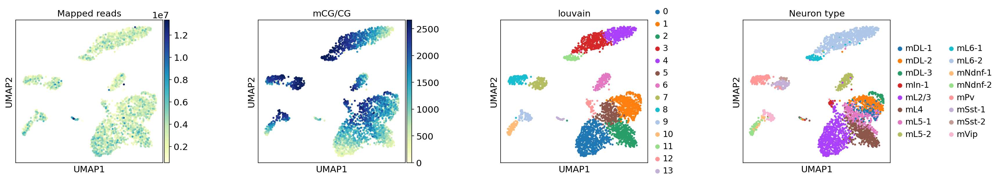

In [145]:
sc.pl.umap(adata,
           color=['Mapped reads','mCG/CG', 'louvain', 'Neuron type'],
           wspace=0.5,
           save='umap_windows_CG_new_colors.png')

In [146]:
adata.uns["Neuron type_colors"] = ['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d']

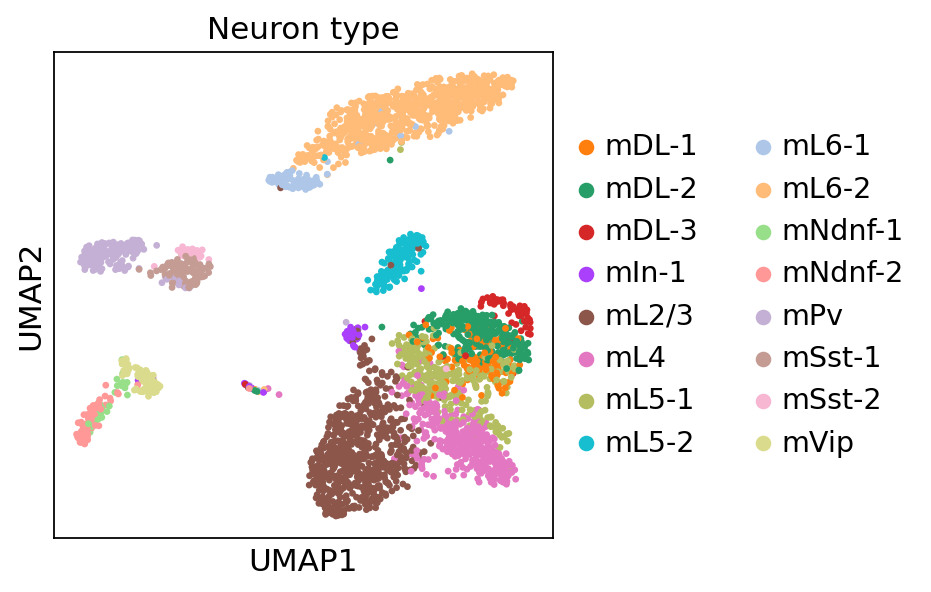

In [147]:
sc.pl.umap(adata,
           color=['Neuron type'],
           wspace=0.5,
           save='umap_windows_CG_new_colors.png')

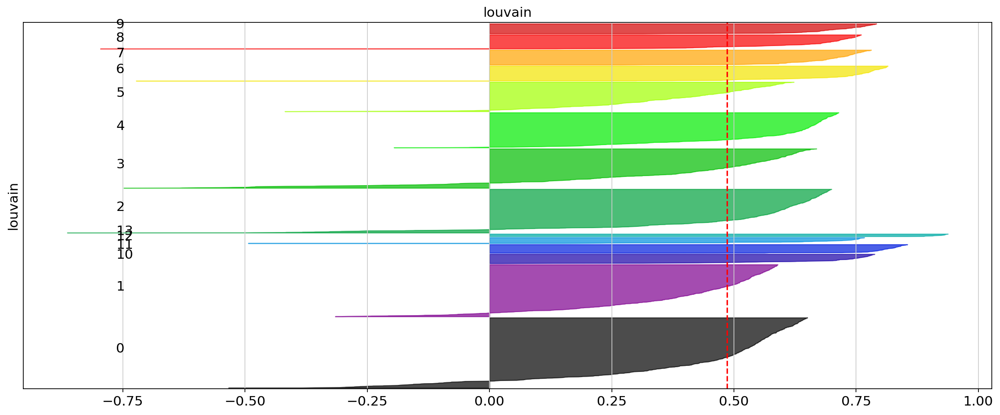

0.48568934


()

In [148]:
epi.pl.silhouette_tot(adata, 'louvain', value='X_umap')

In [149]:
adata.write('windows_processed.h5ad')

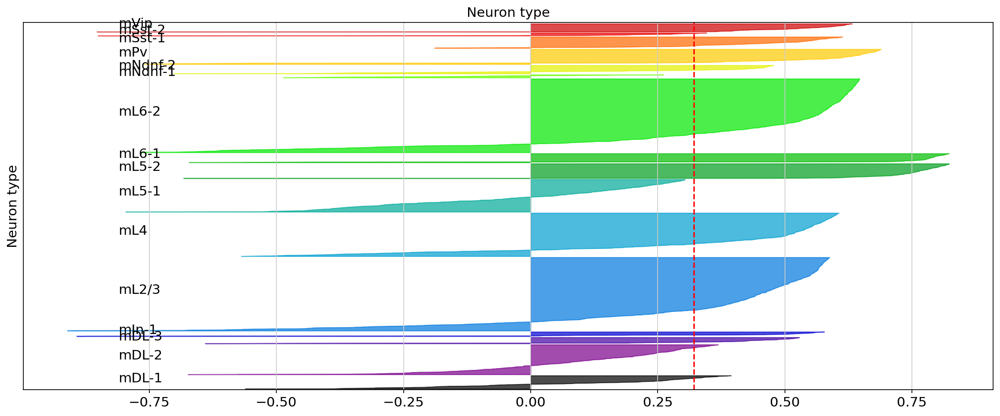

0.3209019


()

In [82]:
epi.pl.silhouette_tot(adata, 'Neuron type',
                      value='X_umap',
                      save='silhouette_umap_windows.png')

<Figure size 800x800 with 0 Axes>

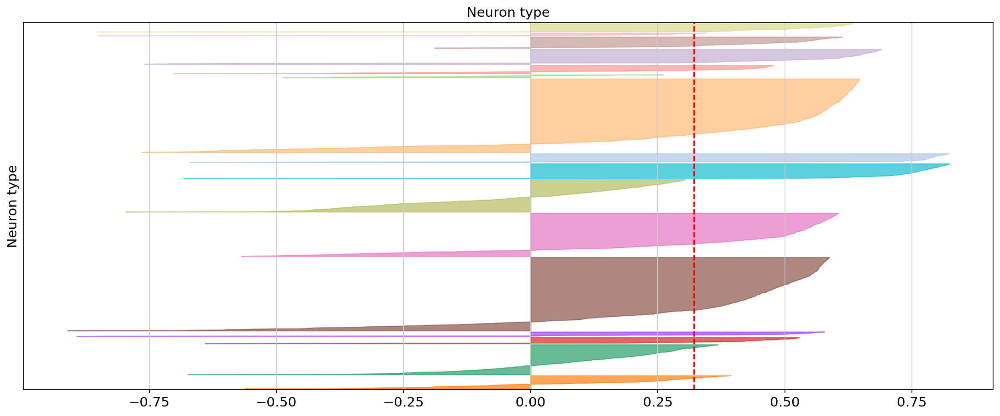

0.3209019


()

In [83]:
silhouette_plot = 'silhouette_umap_windows.png'
plt.figure(figsize=(10,10))
epi.pl.silhouette_tot(adata,
                      'Neuron type',
                      value='X_umap',
                      palette=['#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2',
       '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
       '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
                      name_cluster=False,
                     save=silhouette_plot)


In [84]:
adata_windows = adata.copy()

step 0
got 13 at resolution 1.5
step 1
got 16 at resolution 2.25
step 0
got 15 at resolution 1.5
step 1
got 19 at resolution 2.25
step 2
got 18 at resolution 1.875
step 3
got 16 at resolution 1.6875
step 0
got 10 at resolution 1.5
step 1
got 19 at resolution 2.25
step 2
got 14 at resolution 1.875
step 3
got 16 at resolution 2.0625
step 0
got 18 at resolution 1.5
step 1
got 12 at resolution 0.75
step 2
got 15 at resolution 1.125
step 3


... storing 'louvain_enhancers' as categorical
... storing 'louvain_windows' as categorical
... storing 'louvain_genebodies' as categorical


got 16 at resolution 1.3125


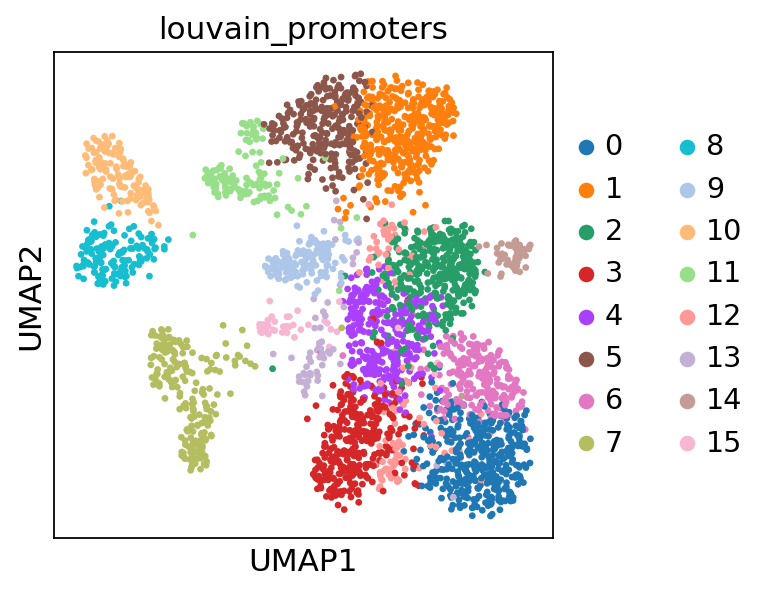

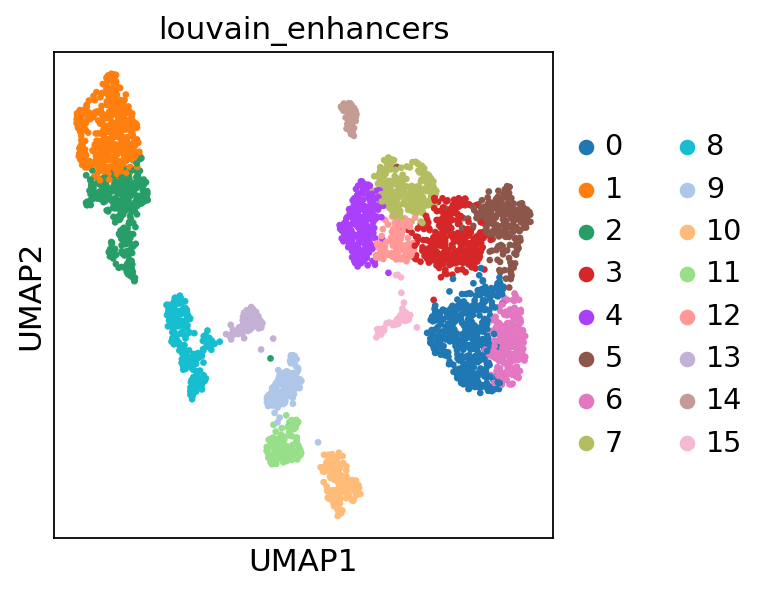

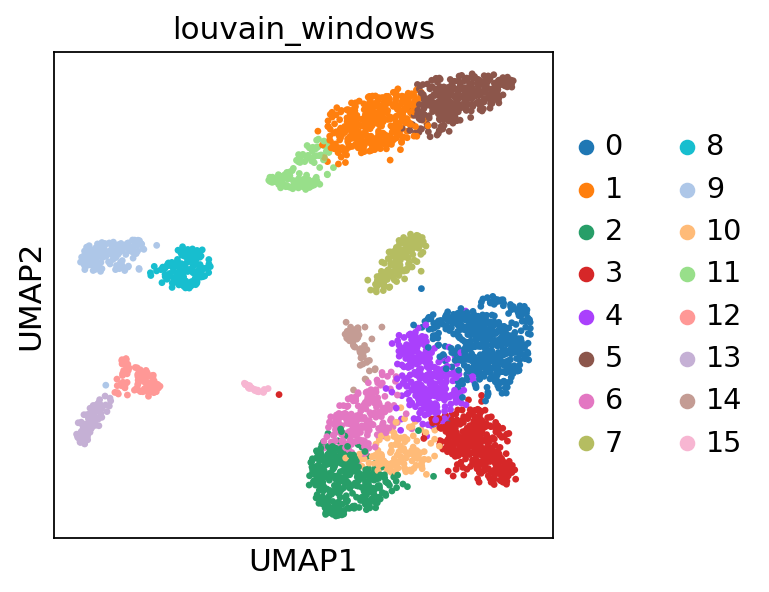

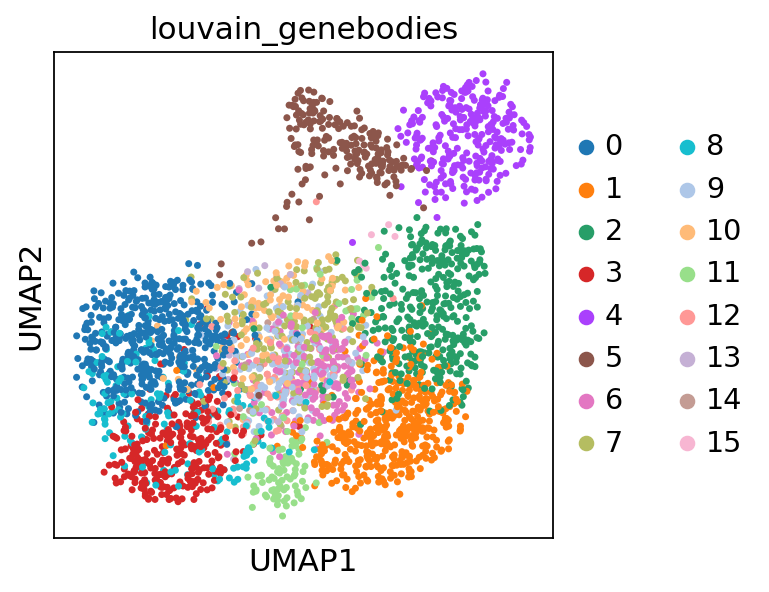

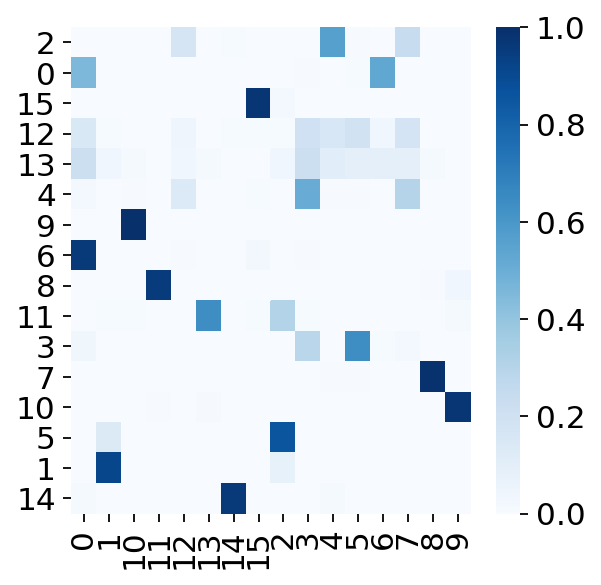

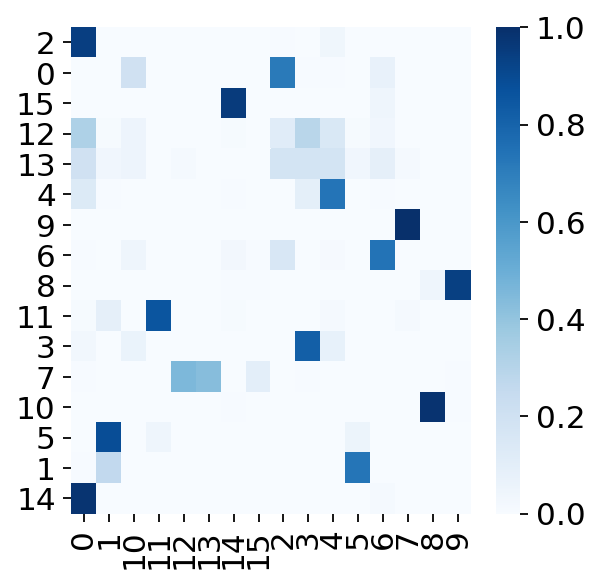

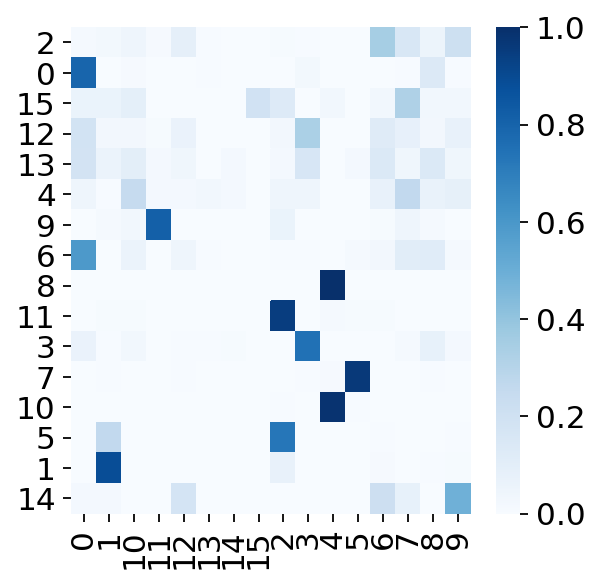

In [147]:
epi.tl.getNClusters(adata_promoter, len(set(adata.obs['Neuron type'])))
epi.tl.getNClusters(adata_windows, len(set(adata.obs['Neuron type'])))
epi.tl.getNClusters(adata_genebodies, len(set(adata.obs['Neuron type'])))
epi.tl.getNClusters(adata_enhancers, len(set(adata.obs['Neuron type'])))


adata_promoter.obs['louvain_promoters'] = adata_promoter.obs['louvain'].copy()
sc.pl.umap(adata_promoter,
           color='louvain_promoters',
          save='louvain_promoters.png')

### enhancers

adata_enhancers.obs['louvain_enhancers'] = adata_enhancers.obs['louvain'].copy()
sc.pl.umap(adata_enhancers,
           color='louvain_enhancers',
          save='louvain_enhancers.png')
cell_label = {}
index = 0
for n in adata_enhancers.obs_names.tolist():
    cell_label[n] = adata_enhancers.obs['louvain_enhancers'][index]
    index += 1
    
annot = []
for n in adata_promoter.obs_names.tolist():
    if n in cell_label.keys():
        annot.append(cell_label[n])
    else:
        annot.append('NA')
adata_promoter.obs['louvain_enhancers'] = annot

### windows

adata_windows.obs['louvain_windows'] = adata_windows.obs['louvain'].copy()
sc.pl.umap(adata_windows,
           color='louvain_windows',
          save='louvain_windows.png')
cell_label = {}
index = 0
for n in adata_windows.obs_names.tolist():
    cell_label[n] = adata_windows.obs['louvain_windows'][index]
    index += 1
    
annot = []
for n in adata_promoter.obs_names.tolist():
    if n in cell_label.keys():
        annot.append(cell_label[n])
    else:
        annot.append('NA')
adata_promoter.obs['louvain_windows'] = annot

### genebodies
    
adata_genebodies.obs['louvain_genebodies'] = adata_genebodies.obs['louvain'].copy()
sc.pl.umap(adata_genebodies,
           color='louvain_genebodies',
          save='louvain_genebodies.png')
cell_label = {}
index = 0
for n in adata_genebodies.obs_names.tolist():
    cell_label[n] = adata_genebodies.obs['louvain_genebodies'][index]
    index += 1
    
annot = []
for n in adata_promoter.obs_names.tolist():
    n = n.rstrip('\n')
    if n in cell_label.keys():
        annot.append(cell_label[n])
    else:
        annot.append('NA')
adata_promoter.obs['louvain_genebodies'] = annot

### confusion plots

adata_tmp=adata_promoter[adata_promoter.obs['louvain_enhancers']!='NA',:].copy()
epi.pl.overlap_heatmap(adata_tmp,
                      'louvain_promoters',
                      'louvain_enhancers',
                      norm=True)
plt.savefig('promoters_VS_enhancers.png')
plt.show()

adata_tmp=adata_promoter[adata_promoter.obs['louvain_windows']!='NA',:].copy()
epi.pl.overlap_heatmap(adata_tmp,
                      'louvain_promoters',
                      'louvain_windows',
                      norm=True)
plt.savefig('promoters_VS_windows.png')
plt.show()

adata_tmp=adata_promoter[adata_promoter.obs['louvain_genebodies']!='NA',:].copy()
epi.pl.overlap_heatmap(adata_tmp,
                      'louvain_promoters',
                      'louvain_genebodies',
                      norm=True)
plt.savefig('promoters_VS_genebodies.png')
plt.show()

... storing 'louvain_enhancers' as categorical
... storing 'louvain_windows' as categorical
... storing 'louvain_genebodies' as categorical


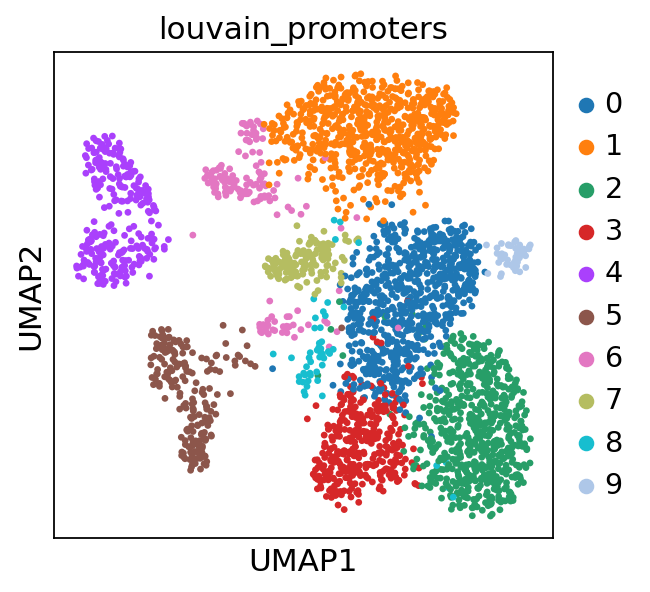

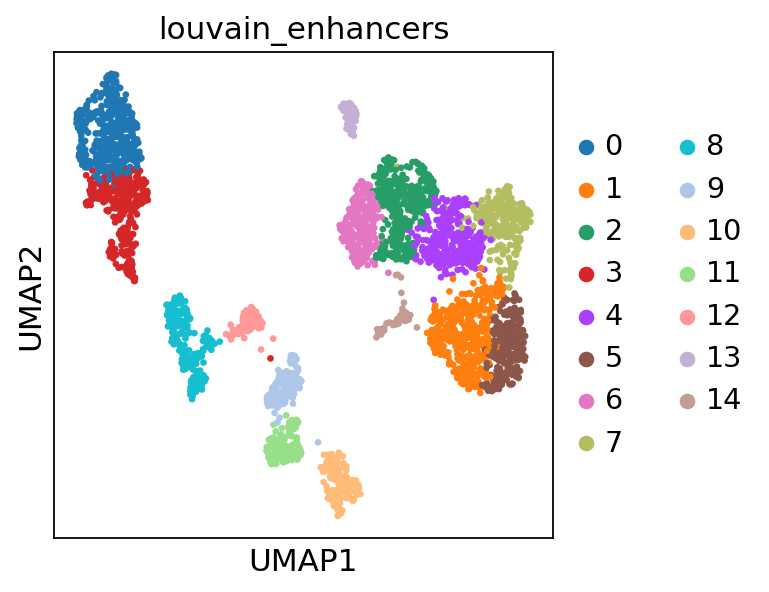

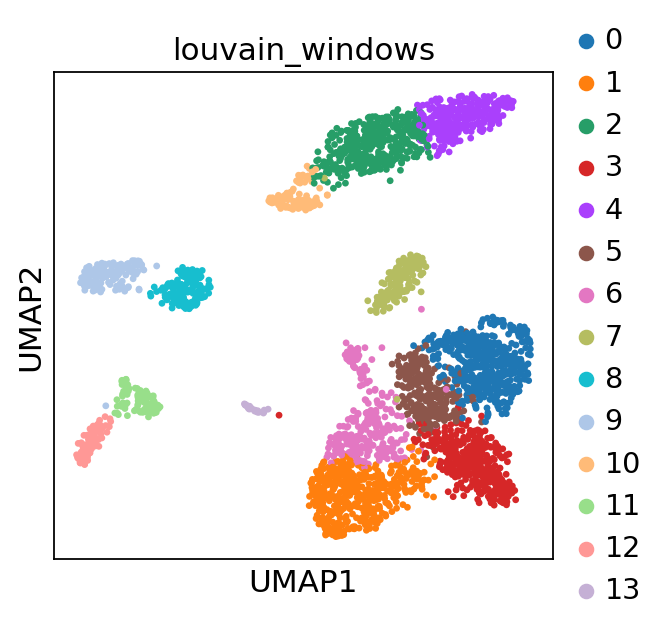

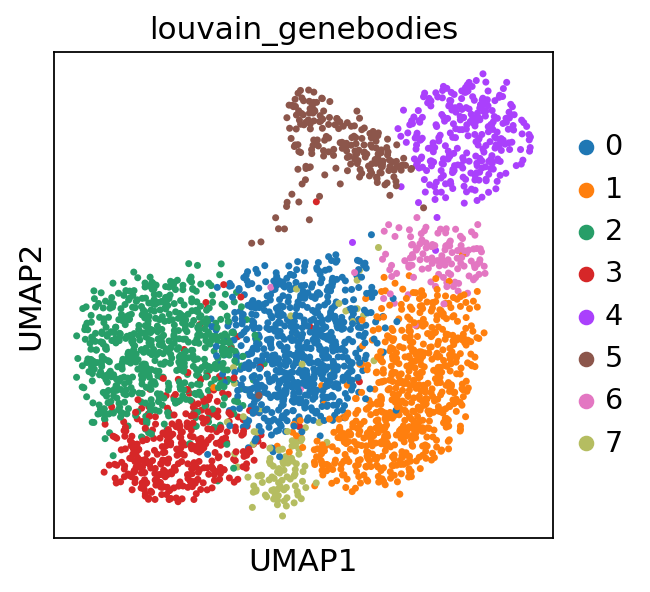

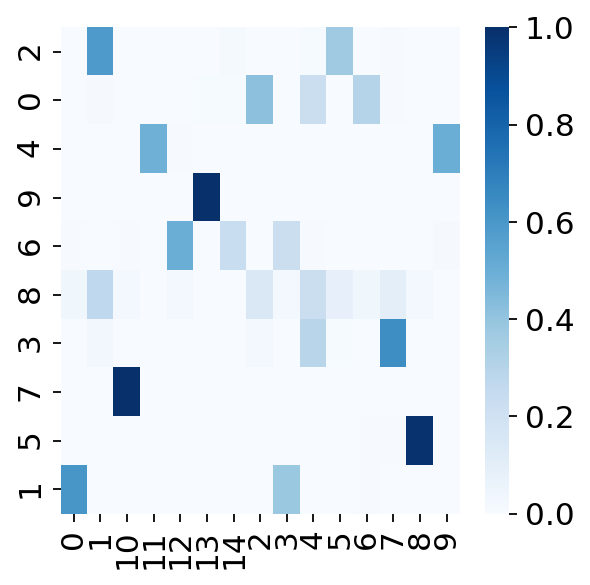

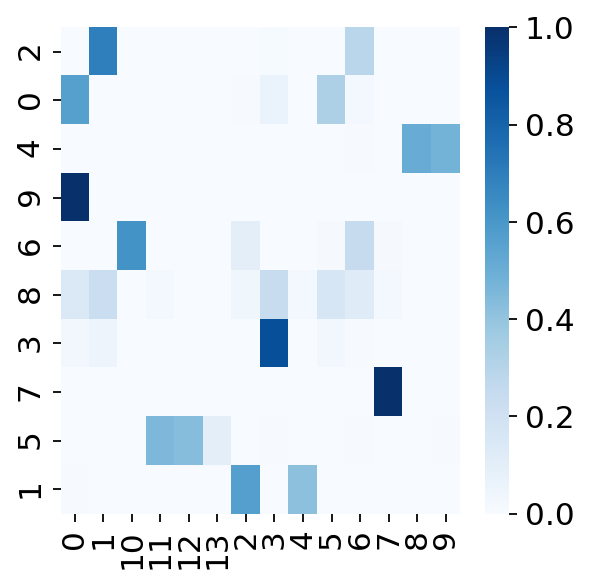

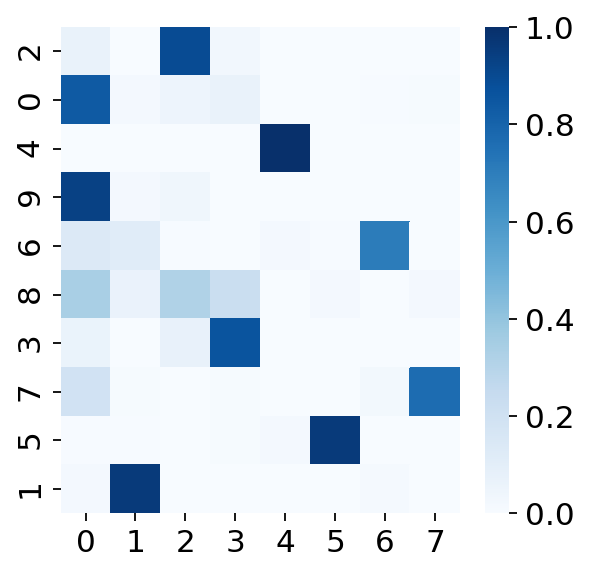

In [146]:
epi.tl.louvain(adata_promoter)
epi.tl.louvain(adata_windows)
epi.tl.louvain(adata_genebodies)
epi.tl.louvain(adata_enhancers)

adata_promoter.obs['louvain_promoters'] = adata_promoter.obs['louvain'].copy()
sc.pl.umap(adata_promoter,
           color='louvain_promoters',
          save='louvain_promoters_resolution1.png')

### enhancers

adata_enhancers.obs['louvain_enhancers'] = adata_enhancers.obs['louvain'].copy()
sc.pl.umap(adata_enhancers,
           color='louvain_enhancers',
          save='louvain_enhancers_resolution1.png')
cell_label = {}
index = 0
for n in adata_enhancers.obs_names.tolist():
    cell_label[n] = adata_enhancers.obs['louvain_enhancers'][index]
    index += 1
    
annot = []
for n in adata_promoter.obs_names.tolist():
    if n in cell_label.keys():
        annot.append(cell_label[n])
    else:
        annot.append('NA')
adata_promoter.obs['louvain_enhancers'] = annot

### windows

adata_windows.obs['louvain_windows'] = adata_windows.obs['louvain'].copy()
sc.pl.umap(adata_windows,
           color='louvain_windows',
          save='louvain_windows_resolution1.png')
cell_label = {}
index = 0
for n in adata_windows.obs_names.tolist():
    cell_label[n] = adata_windows.obs['louvain_windows'][index]
    index += 1
    
annot = []
for n in adata_promoter.obs_names.tolist():
    if n in cell_label.keys():
        annot.append(cell_label[n])
    else:
        annot.append('NA')
adata_promoter.obs['louvain_windows'] = annot

### genebodies
    
adata_genebodies.obs['louvain_genebodies'] = adata_genebodies.obs['louvain'].copy()
sc.pl.umap(adata_genebodies,
           color='louvain_genebodies',
          save='louvain_genebodies_resolution1.png')
cell_label = {}
index = 0
for n in adata_genebodies.obs_names.tolist():
    cell_label[n] = adata_genebodies.obs['louvain_genebodies'][index]
    index += 1
    
annot = []
for n in adata_promoter.obs_names.tolist():
    n = n.rstrip('\n')
    if n in cell_label.keys():
        annot.append(cell_label[n])
    else:
        annot.append('NA')
adata_promoter.obs['louvain_genebodies'] = annot

### confusion plots

adata_tmp=adata_promoter[adata_promoter.obs['louvain_enhancers']!='NA',:].copy()
epi.pl.overlap_heatmap(adata_tmp,
                      'louvain_promoters',
                      'louvain_enhancers',
                      norm=True)
plt.savefig('promoters_VS_enhancers_resolution1.png')
plt.show()

adata_tmp=adata_promoter[adata_promoter.obs['louvain_windows']!='NA',:].copy()
epi.pl.overlap_heatmap(adata_tmp,
                      'louvain_promoters',
                      'louvain_windows',
                      norm=True)
plt.savefig('promoters_VS_windows_resolution1.png')
plt.show()

adata_tmp=adata_promoter[adata_promoter.obs['louvain_genebodies']!='NA',:].copy()
epi.pl.overlap_heatmap(adata_tmp,
                      'louvain_promoters',
                      'louvain_genebodies',
                      norm=True)
plt.savefig('promoters_VS_genebodies_resolution1.png')
plt.show()

# extra CG promoter plots

In [107]:
adata = adata_promoter.copy()

... storing 'louvain_enhancers' as categorical
... storing 'louvain_windows' as categorical
... storing 'louvain_genebodies' as categorical


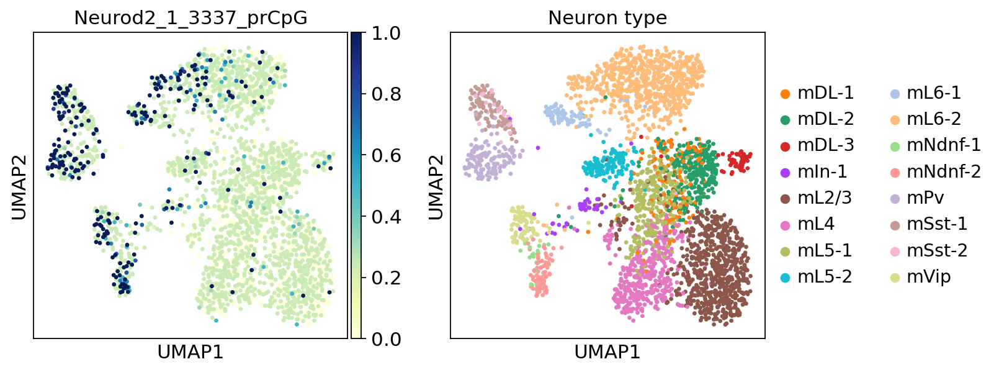

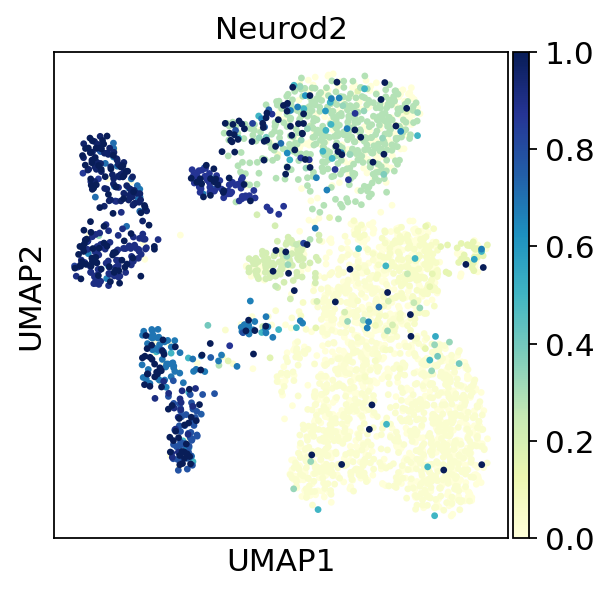

In [108]:
imputation(adata, 'Neurod2_1_3337_prCpG','Neuron type')
sc.pl.umap(adata, color=['Neurod2_1_3337_prCpG', 'Neuron type'])
sc.pl.umap(adata, color=['Neurod2_1_3337_prCpG_imputed'],
           title='Neurod2', save='Neurod2.png')
adata.obs['Neurod2'] = adata.obs['Neurod2_1_3337_prCpG_imputed'].copy()


In [ ]:
sc.pl.violin(adata, 
             keys='Neurod2',rotation=90,
            groupby='Neuron type', save='Neurod2_neuron_type.png')

